# Denoising: Traditional Methods

In [3]:
# COMPLETE
channels_128 = [
    # Frontal
    'FP1', 'FPz', 'FP2',
    'AFp1', 'AFPz', 'AFp2',
    'AF7', 'AF3', 'AF4', 'AF8',
    'AFF5h', 'AFF1h', 'AFF2h', 'AFF6h',
    'F9', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'F10',

    # Fronto-Temporal
    'FFT9h', 'FFT7h',
    'FFC5h', 'FFC3h', 'FFC1h', 'FFC2h', 'FFC4h', 'FFC6h',
    'FFT8h', 'FFT10h',
    'FT9', 'FT7', 'FT8', 'FT10',

    # Fronto-Central
    'FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6',
    'FTT9h', 'FTT7h',
    'FCC5h', 'FCC3h', 'FCC1h', 'FCC2h', 'FCC4h', 'FCC6h',
    'FTT8h', 'FTT10h',

    # Central & Temporal
    'T7', 'T8',
    'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6',

    # Centro-Parietal
    'TTP7h', 'CCP5h', 'CCP3h', 'CCP1h', 'CCP2h', 'CCP4h', 'CCP6h', 'TTP8h',
    'CP5', 'CP3', 'Cpz', 'CP4', 'CP6',

    # Parietal
    'TP9', 'TP7', 'TP8', 'TP10',
    'TPP9h', 'TPP7h', 'CPP5h', 'CPP3h', 'CPP1h', 'CPP2h', 'CPP4h', 'CPP6h', 'TPP8h', 'TPP10h',
    'P9', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'P10',

    # Parieto-Occipital
    'PPO9h', 'PPO5h', 'PPO1h', 'PPO2h', 'PPO6h', 'PPO10h',
    'PO9', 'PO7', 'PO3', 'POz', 'PO4', 'PO8', 'PO10',
    'POO9h', 'POO1', 'POO2', 'POO10h',

    # Occipital & Inferior
    'O1', 'Oz', 'O2',
    'OI1h', 'OI2h',
    'I1', 'Iz', 'I2'
]

print(len(channels_128))

128


In [5]:
# Used in BRAINS
channels_32 = ["FP1", "AF3", "F3", "FC1", "C3", "FC3", "T7", "CP5",
               "CPP1h", "P1", "P7", "P9", "PO3", "O1", "OI1h", "POz", 
               "Oz", "OI2h", "O2", "PO4", "P10", "P8", "P2", "CPP2h",
               "CP6", "T8", "FC4", "C4", "FC2", "F4", "AF4", "FP2"]

print(len(channels_32))

32


In [5]:
ch32_idxin_ch128 = []
for i in range(len(channels_32)):
    for j in range(len(channels_128)):
        if (channels_32[i] == channels_128[j]):
            ch32_idxin_ch128.append(j)
print(ch32_idxin_ch128)

[0, 7, 17, 41, 59, 40, 56, 73, 86, 96, 93, 92, 111, 120, 123, 112, 121, 124, 122, 113, 102, 101, 98, 87, 77, 57, 44, 63, 43, 21, 8, 2]


## Data Preview (Before Denoising)

### Load Data (Batch from File)

In [ ]:
import numpy as np
import pandas as pd
from keras.utils import to_categorical

def batch_generator ( df, 
                      n, 
                      start_idx, 
                      start_timestep,
                      end_timestep,
                      selected_channels,
                      batch_size,
                      stats_loc ):
    
    # Modified from: https://medium.com/analytics-vidhya/train-keras-model-with-large-dataset-batch-training-6b3099fdf366
    idx = 1
    steps = int(np.ceil(n / (batch_size // 2)))
    
    while True:
        start_row = start_idx + (idx-1) * batch_size
        skip = list(range(1, start_row + 1))
        
        print(f"Yielding batch idx={idx}, skiprows={start_row}", flush=True)
        yield load_data( df, 
                         skip, 
                         start_timestep,
                         end_timestep, 
                         selected_channels,
                         batch_size,
                         stats_loc )
        if idx < steps:
            idx += 1
        else:
            idx = 1

In [ ]:
def load_data ( df, 
                skip, 
                start_timestep,
                end_timestep, 
                selected_channels,
                batch_size,
                stats_loc ):
    
    # Modified from: https://medium.com/analytics-vidhya/train-keras-model-with-large-dataset-batch-training-6b3099fdf366
    df = pd.read_csv (
                  df, 
                  skiprows = skip,
                  nrows    = batch_size )
    n_channels = len(selected_channels)
    n_timesteps = (end_timestep - start_timestep) + 1

    # Remove Data with Label -1
    data = df[df['label'] != -1]

    # Take Selected Channels and Timesteps' Columns
    selected_columns = [col for col in data.columns
                        if any(col.startswith(ch + '_') \
                               and start_timestep <= int(col.split('_')[-1]) <= end_timestep
                               for ch in selected_channels)
                        or col == 'label']
    data = data[selected_columns].astype(np.float32)

    
    # NORMALIZATION
    if (stats_loc != ''):
        stats_df = pd.read_csv(stats_loc)
        for idx, ch_name in enumerate(selected_channels):
            ch_mean = stats_df.loc[stats_df['channel'] == ch_name, 'mean'].values[0]
            ch_std = stats_df.loc[stats_df['channel'] == ch_name, 'std'].values[0]
            
            start_col = idx * n_timesteps
            end_col = (idx + 1) * n_timesteps
        
            data.iloc[:, start_col:end_col] = \
                (data.iloc[:, start_col:end_col] - ch_mean) / ch_std

    
    # INTEGRATION AND RESHAPE
    data_array = data.iloc[:, :-1].values \
                                  .reshape((-1, n_channels, n_timesteps)) \
                                  .astype(np.float32)
    labels = data['label'].values

    
    return (data_array, to_categorical(labels, num_classes=10).astype('float32'))

In [ ]:
data_generator     = batch_generator (
    df                = '/kaggle/input/raw-eeg-2b/X_raw_train2B.csv',
    n                 = 30000,
    start_idx         = 0,
    start_timestep    = 0,
    end_timestep      = 499,
    selected_channels = channels_32,
    batch_size        = 2*500,
    stats_loc         = ''
)

In [ ]:
X_batch = []
y_batch = []

for _ in range(20):
    X, y = next(data_generator)
    X_batch.append(X)
    y_batch.append(y)

In [ ]:
X_batch = np.array(X_batch)
y_batch = np.array(y_batch)

X = X_batch.reshape(10000, 32, 500)
y = y_batch.reshape(10000, 10) 

In [ ]:
print(X.shape)
print(y.shape)

### Load Data (Batch from Hugging Face)

In [19]:
from datasets import load_dataset
from itertools import islice
import pandas as pd
import numpy as np
from keras.utils import to_categorical

dataset = load_dataset("DavidVivancos/MindBigData2023_MNIST-2B", split="train", streaming=True)
batch_iterator = iter(dataset)

In [20]:
X_batch = []
y_batch = []

n_channels = 32
n_timesteps = 256

batch_size = 3000
for i in range(20):
    print(f"Retrieving batch {i}...", flush=True)
    batch = list(islice(batch_iterator, batch_size))
    batch = pd.DataFrame(batch)

    # Remove Data with Label -1
    data = batch[batch['label'] != -1]

    # Take Selected Channels and Timesteps' Columns
    selected_columns = [col for col in data.columns
                        if any(col.startswith(ch + '_') \
                               and 0 <= int(col.split('_')[-1]) <= 255
                               for ch in channels_32)
                        or col == 'label']
    data = data[selected_columns]

    # INTEGRATION AND RESHAPE
    data_array = data.iloc[:, :-1].values \
                                  .reshape((-1, n_channels, n_timesteps)) \
                                  .astype(np.float32)
    labels = data['label'].values

    X_batch.append(data_array)
    y_batch.append(to_categorical(labels, num_classes=10).astype('float32'))\

X = np.concatenate(X_batch, axis=0)
y = np.concatenate(y_batch, axis=0)

Retrieving batch 0...
Retrieving batch 1...
Retrieving batch 2...
Retrieving batch 3...
Retrieving batch 4...
Retrieving batch 5...
Retrieving batch 6...
Retrieving batch 7...
Retrieving batch 8...
Retrieving batch 9...
Retrieving batch 10...
Retrieving batch 11...
Retrieving batch 12...
Retrieving batch 13...
Retrieving batch 14...
Retrieving batch 15...
Retrieving batch 16...
Retrieving batch 17...
Retrieving batch 18...
Retrieving batch 19...


In [21]:
print(X.shape)
print(y.shape)

(30000, 32, 256)
(30000, 10)


### Metrics Function

In [4]:
import numpy as np
from collections import defaultdict
from scipy.spatial.distance import cosine, euclidean

In [8]:
def calculate_metrics(latent_vectors, labels):
    cosine_results = cosine_stats(latent_vectors, labels)
    euclidean_results = euclidean_stats(latent_vectors, labels)
    combined_results = {}
    for label in set(list(cosine_results.keys()) + list(euclidean_results.keys())):
        combined_results[label] = {
            **cosine_results.get(label, {}),
            **euclidean_results.get(label, {})
        }
    return combined_results


def print_metrics(metrics_dict):
    print("\n\n=================================================== METRICS  SUMMARY ===================================================")
    headers = ["Label", "Theta Min", "Theta Max", "Theta Avg", "Euclidean Min", "Euclidean Max", "Euclidean Avg"]
    print(f"{headers[0]:<10} | {headers[1]:<15} | {headers[2]:<15} | {headers[3]:<15} | {headers[4]:<15} | {headers[5]:<15} | {headers[6]:<15}")
    print("-" * 120)

    for label, metrics in metrics_dict.items():
        theta_min = metrics['min_theta']
        theta_max = metrics['max_theta']
        theta_avg = metrics['avg_theta']
        euclidean_min = metrics['min_euclidean']
        euclidean_max = metrics['max_euclidean']
        euclidean_avg = metrics['avg_euclidean']

        print(f"{label:<10} | {theta_min:<15.6f} | {theta_max:<15.6f} | {theta_avg:<15.6f} | {euclidean_min:<15.6f} | {euclidean_max:<15.6f} | {euclidean_avg:<15.6f}")

    print("-" * 120)

#### Euclidean Distance

In [7]:
def euclidean_stats(latent_vectors, labels):
    class_stats = defaultdict(dict)
    unique_labels = np.unique(labels)

    for label in unique_labels:
        # Filter latent vectors for current class
        class_vectors = latent_vectors[labels == label]
        num_vectors = class_vectors.shape[0]

        distances = []
        for i in range(num_vectors):
            for j in range(i + 1, num_vectors):
                dist = euclidean(class_vectors[i], class_vectors[j])
                distances.append(dist)

        class_stats[label]['min_euclidean'] = np.min(distances)
        class_stats[label]['max_euclidean'] = np.max(distances)
        class_stats[label]['avg_euclidean'] = np.mean(distances)

    return class_stats

#### Cosine Similarity

In [6]:
def theta_difference(v1, v2):
    # Cosine similarity
    cos_theta = np.dot(v1, v2) / (np.linalg.norm(v1) * np.linalg.norm(v2))
    cos_theta = np.clip(cos_theta, -1.0, 1.0)
    theta = np.arccos(cos_theta) * (180 / np.pi)
    return theta


def cosine_stats(latent_vectors, labels):
    class_stats = defaultdict(dict)
    unique_labels = np.unique(labels)

    for label in unique_labels:
        # Filter latent vectors for current class
        class_vectors = latent_vectors[labels == label]
        num_vectors = class_vectors.shape[0]

        differences = []
        for i in range(num_vectors):
            for j in range(i + 1, num_vectors):
                theta = theta_difference(class_vectors[i], class_vectors[j])
                differences.append(theta)

        class_stats[label]['min_theta'] = np.min(differences)
        class_stats[label]['max_theta'] = np.max(differences)
        class_stats[label]['avg_theta'] = np.mean(differences)

    return class_stats

### Compute Metrics

In [73]:
labels = np.argmax(y, axis=1)
print_metrics(calculate_metrics(X.reshape(X.shape[0], -1), labels))



=================================================== METRICS  SUMMARY ===================================================
Label      | Theta Min       | Theta Max       | Theta Avg       | Euclidean Min   | Euclidean Max   | Euclidean Avg  
------------------------------------------------------------------------------------------------------------------------
0          | 17.832218       | 162.246482      | 89.731269       | 1015335.187500  | 12669506.000000 | 2389686.790793 
1          | 14.887659       | 164.287077      | 89.753301       | 1022017.500000  | 14942140.000000 | 2398177.508802 
2          | 16.739564       | 161.646810      | 89.719131       | 1047706.812500  | 12368639.000000 | 2439234.756761 
3          | 19.151595       | 161.726662      | 89.741342       | 1012849.125000  | 13745735.000000 | 2455008.352518 
4          | 20.757887       | 157.215037      | 89.684160       | 1020424.250000  | 11943358.000000 | 2398185.473721 
5          | 16.585695       | 161.944509 

### Visualization

In [11]:
import matplotlib.pyplot as plt

def show_sample_per_label_per_channel(ch_num, ch_name, X_batch, y_labels, num=100):
    for cls in range(10):
        plt.figure(figsize=(16, 8))
        for i in range(num):
            idx = np.where(y_labels == cls)[0][i]
            plt.plot(X_batch[idx, ch_num, :], label=f"Sample {i+1}")
            
        plt.title(f"Samples from Label {cls} (Channel {ch_name})")
        plt.xlabel("Timestep")
        plt.ylabel("Amplitude")
        plt.legend(loc='upper right')
        plt.show()

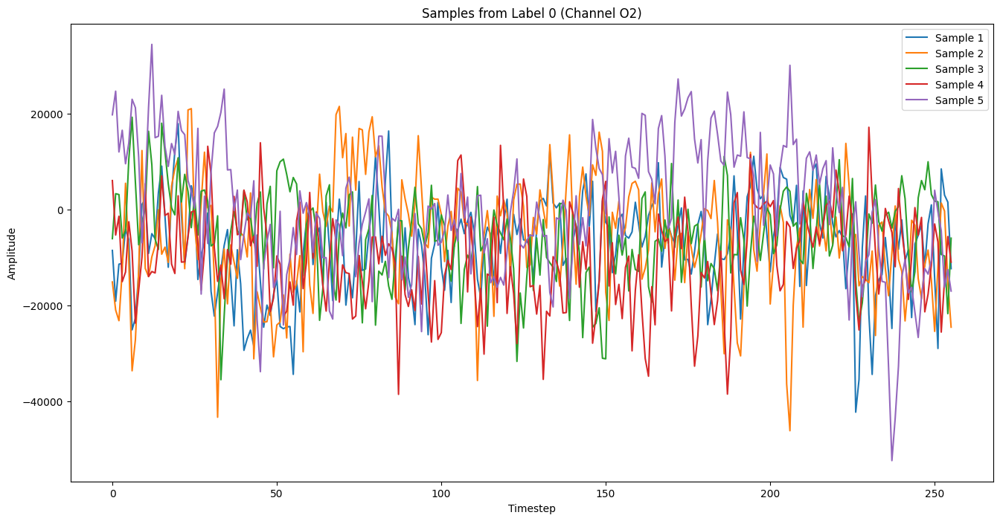

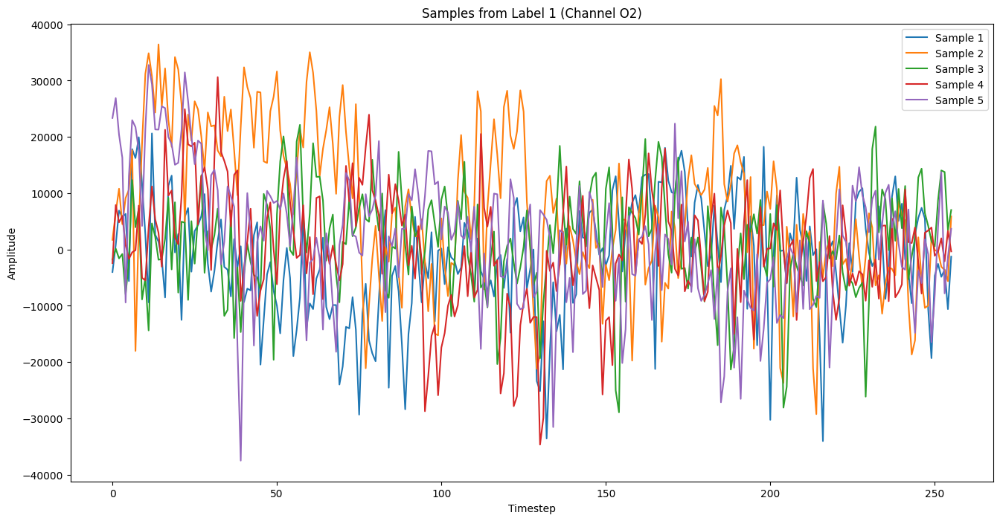

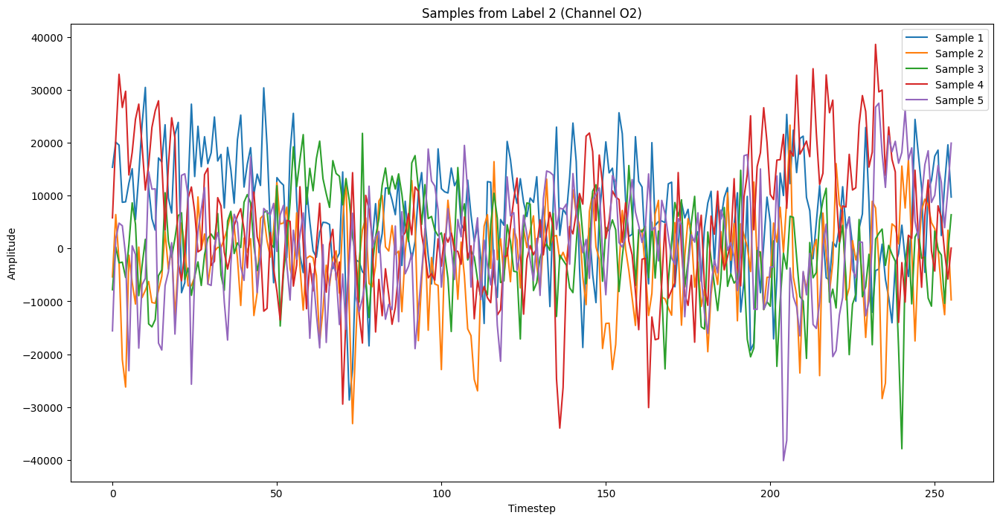

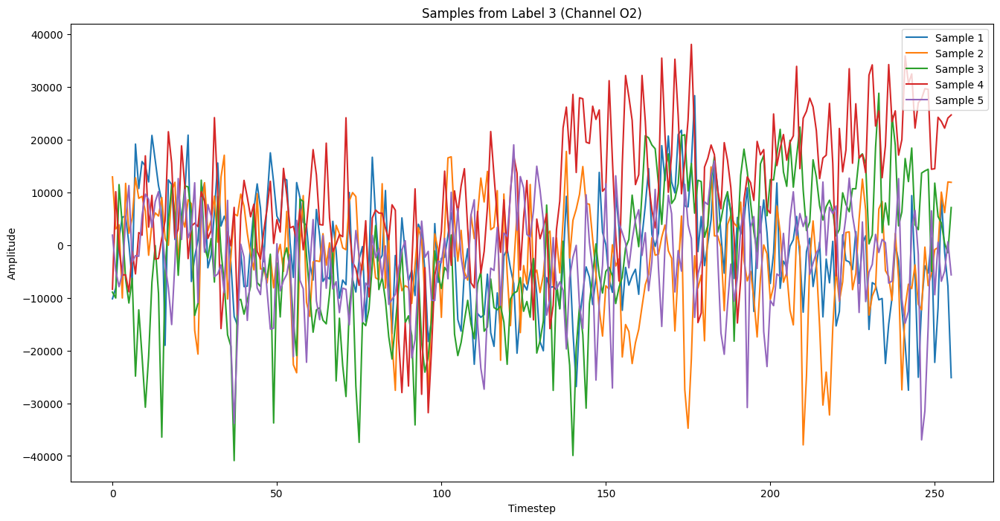

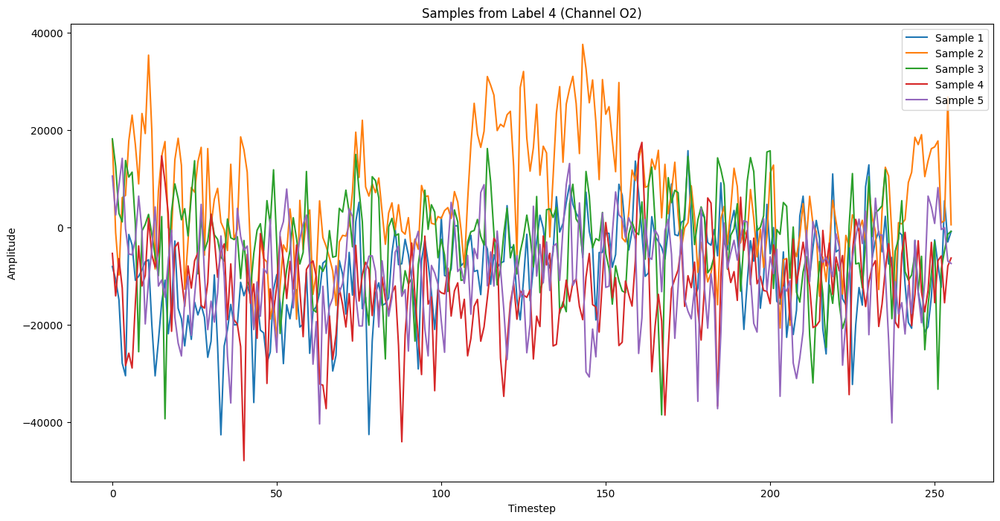

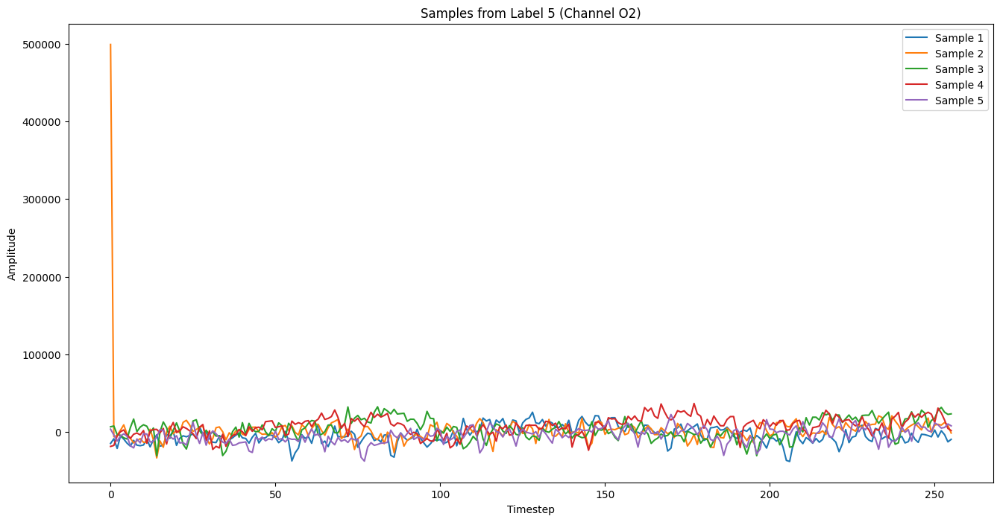

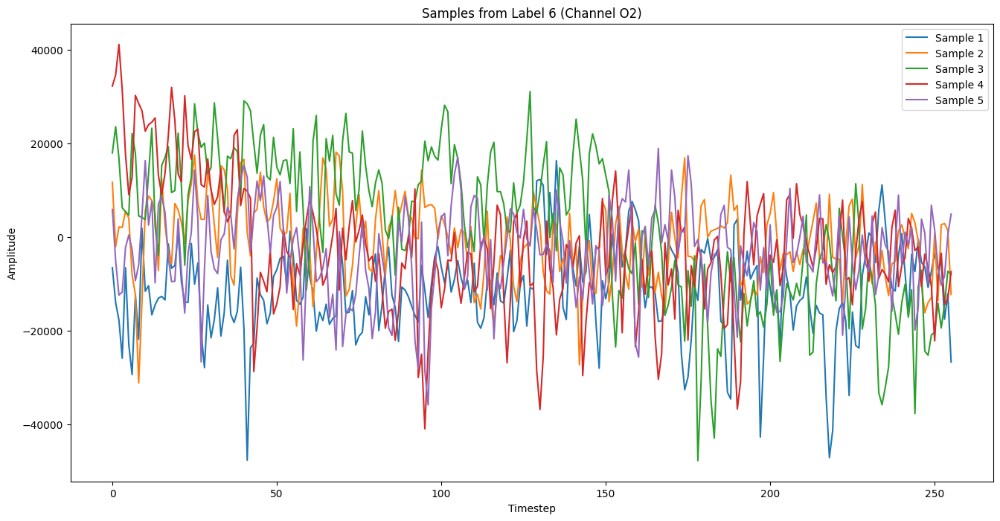

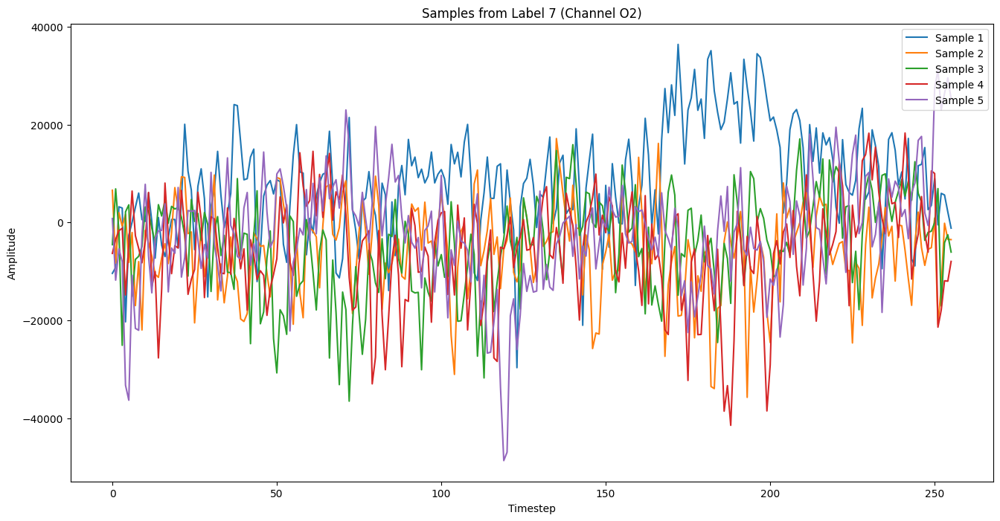

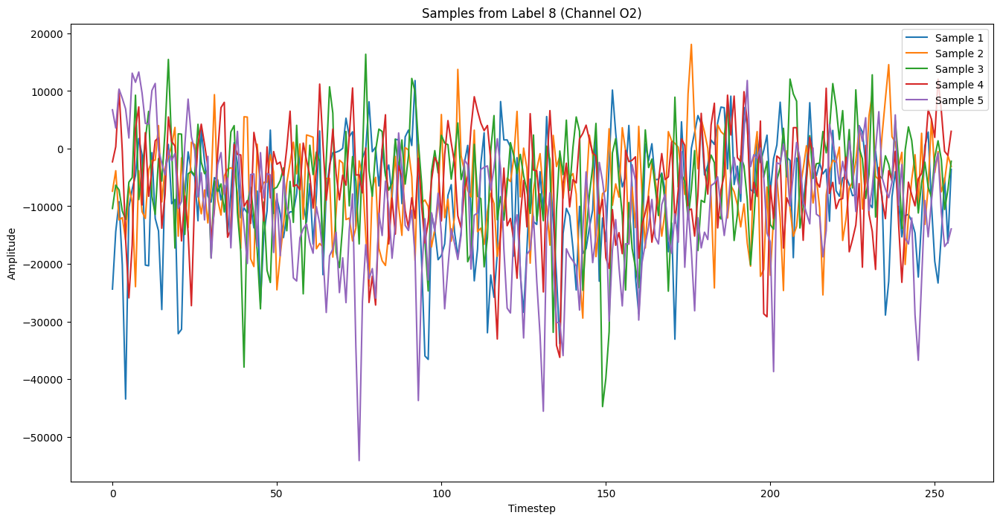

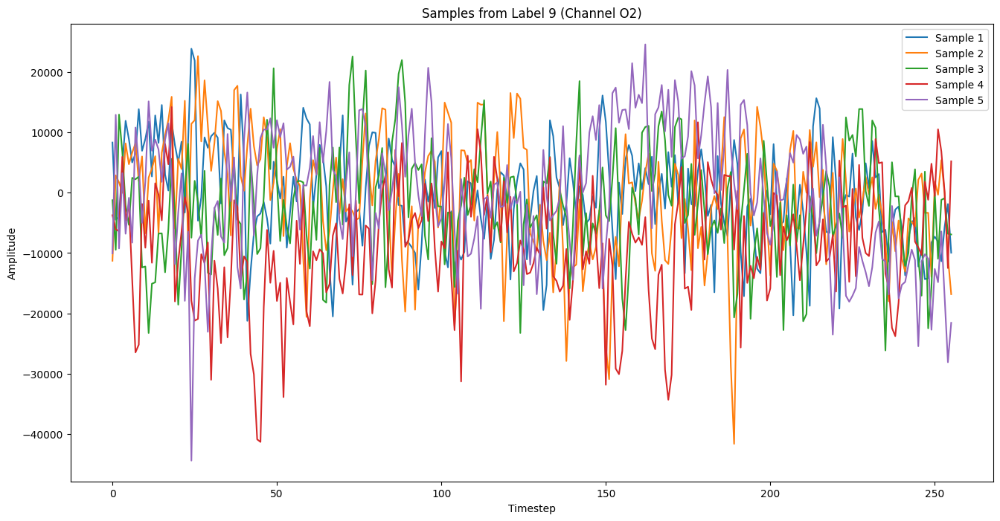

In [5]:
# for i in range(len(channels_32)):
#     show_sample_per_label_per_channel(i, channels_32[i], X, labels, 10)

show_sample_per_label_per_channel(18, channels_32[18], X, labels, 5)

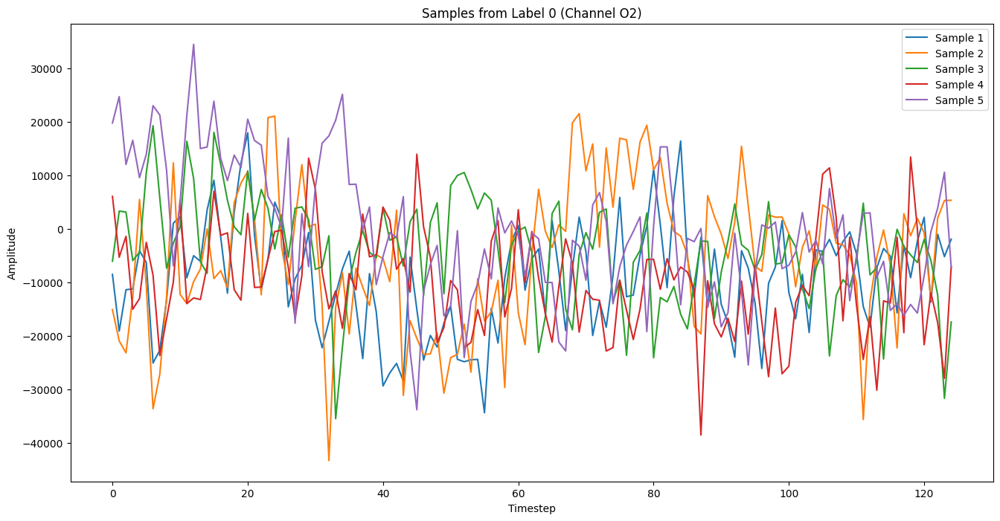

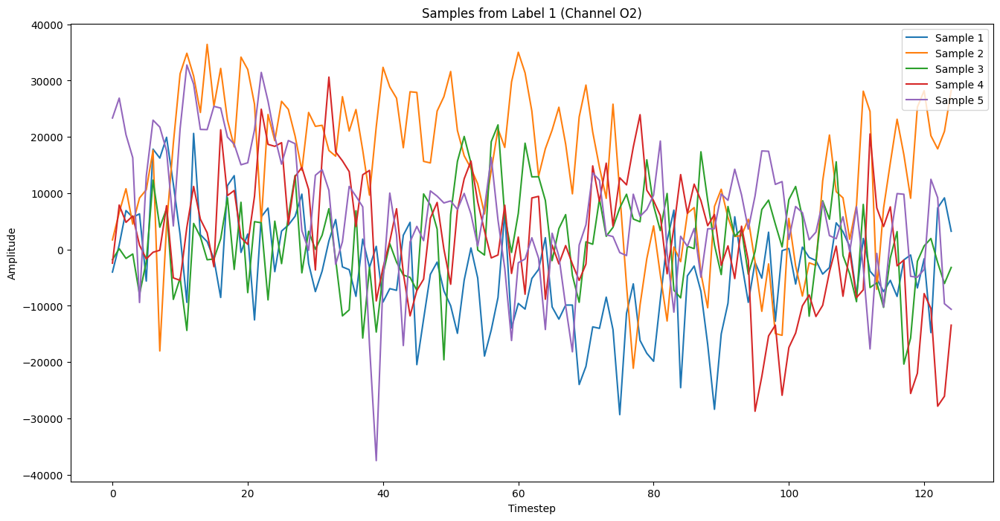

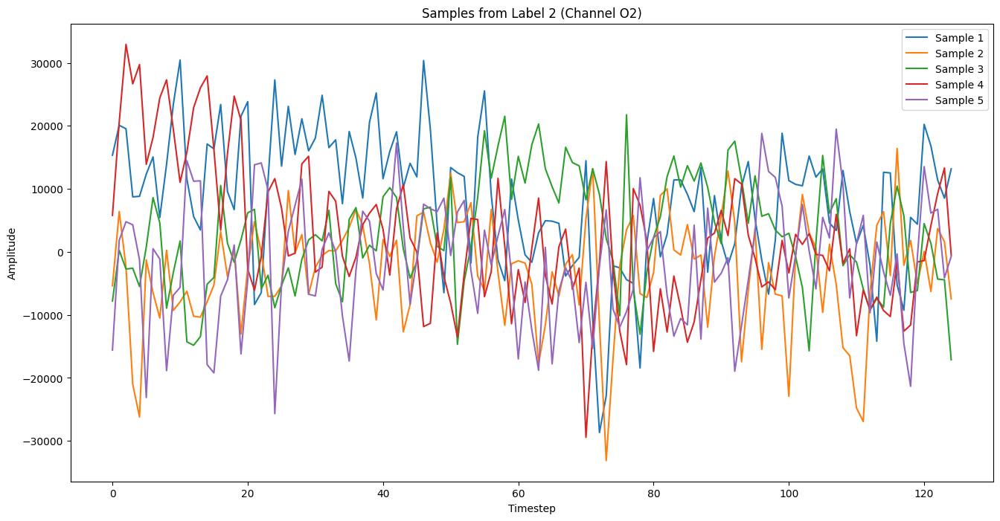

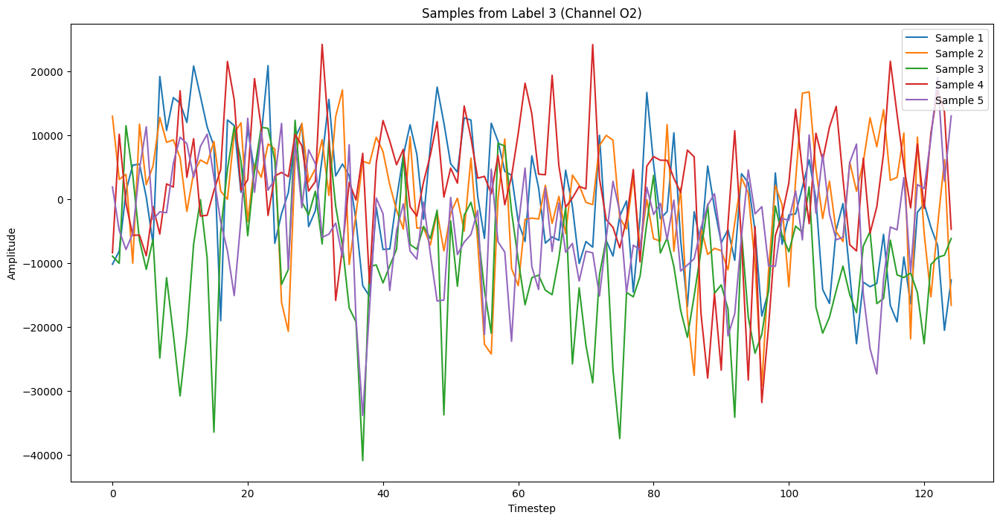

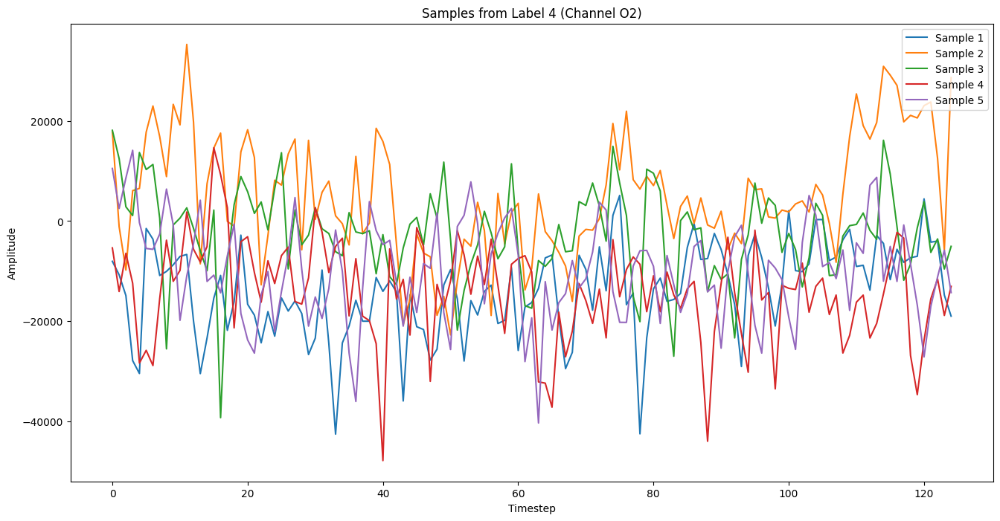

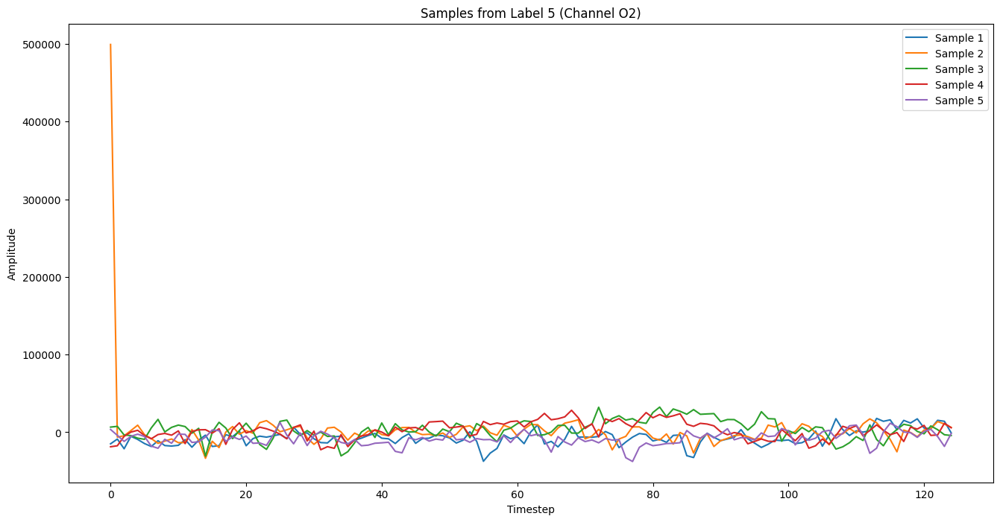

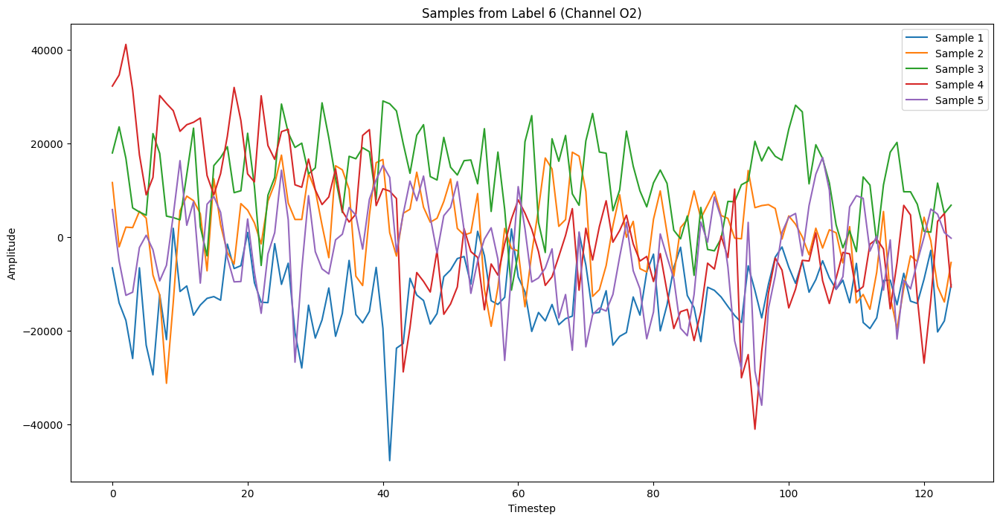

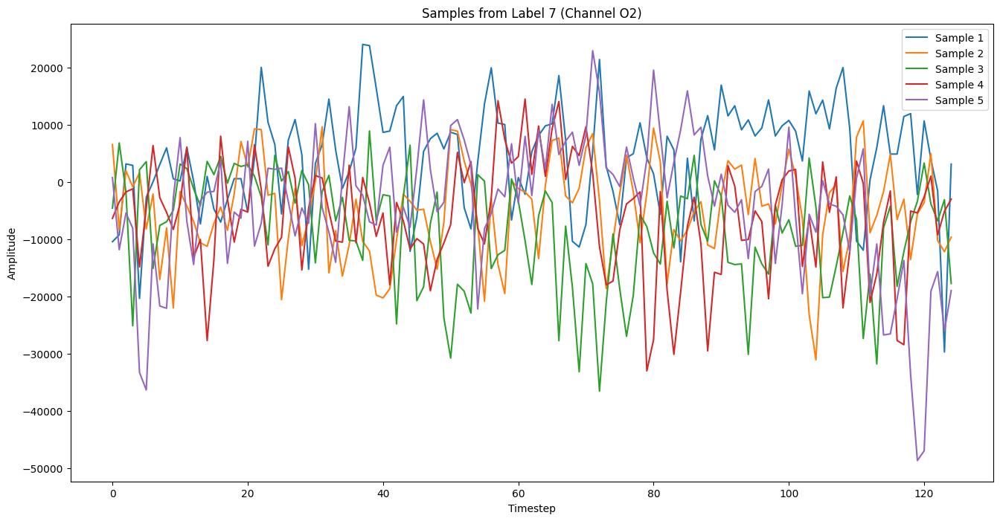

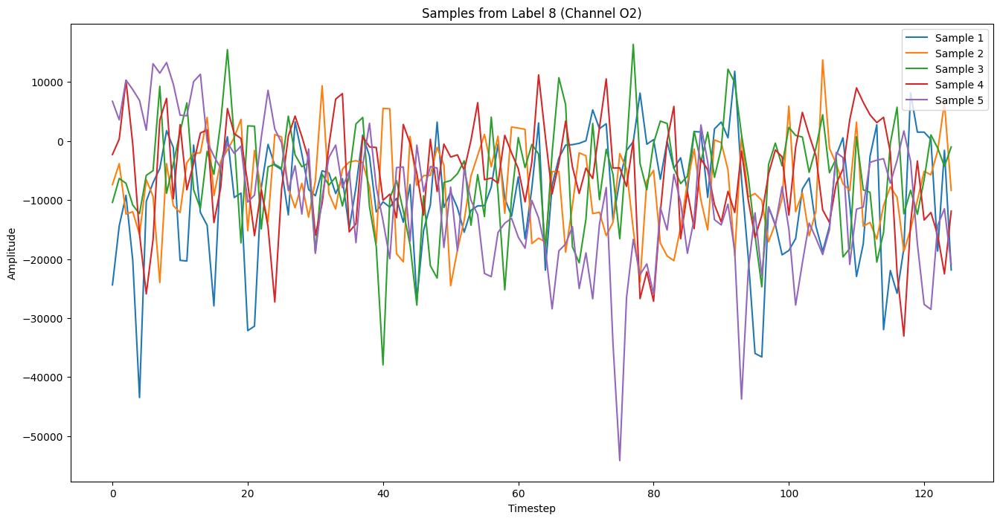

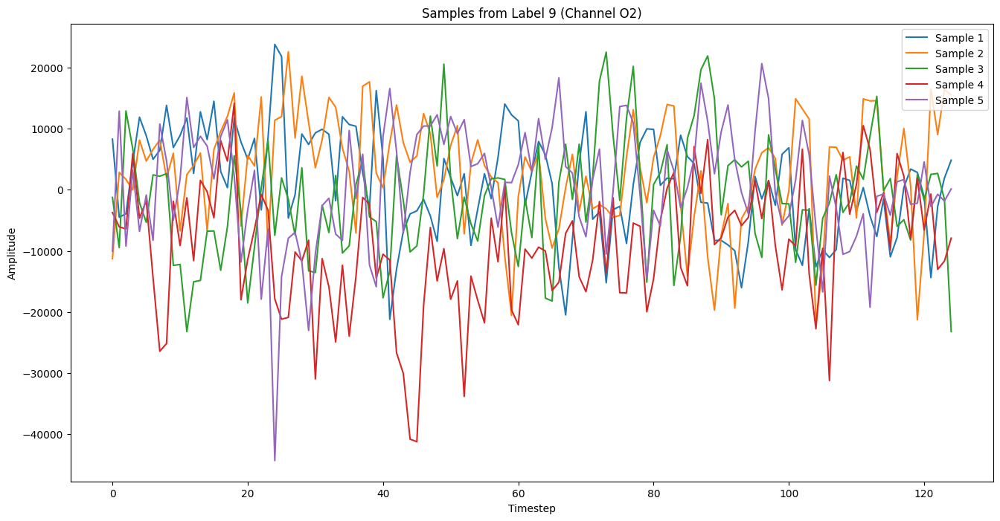

In [6]:
show_sample_per_label_per_channel(18, channels_32[18], X[:, :, :125], labels, 5)

#### t-SNE

In [54]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def visualize_tSNE(perplexity, lr, X_batch, labels, title, xlim, ylim):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    
    tsne = TSNE ( 
        n_components  = 2,
        perplexity    = perplexity,
        learning_rate = lr,
        n_iter        = 1000,
        random_state  = 42,
        init          = 'pca',
    )
    embedding = tsne.fit_transform(data_flat)
    
    plt.figure(figsize=(8,6))
    for label in np.unique(labels):
        idxs = labels == label
        plt.scatter(embedding[idxs, 0], embedding[idxs, 1], label=f"Label {label}", alpha=0.6)
    plt.title(f"{title}, perplexity:{perplexity}, learning_rate:{lr}")
    
    if (xlim != '' and ylim != ''):
        plt.xlim(xlim)
        plt.ylim(ylim)
        
    plt.legend()
    plt.grid(True)
    plt.show()

    print(f"Final KL-Divergence: {tsne.kl_divergence_}")
    if (xlim != '' and ylim != ''):
        out_of_x = np.logical_or(embedding[:, 0] < xlim[0], embedding[:, 0] > xlim[1])
        out_of_y = np.logical_or(embedding[:, 1] < ylim[0], embedding[:, 1] > ylim[1])
        out_of_bounds = np.logical_or(out_of_x, out_of_y)
        num_outliers = np.sum(out_of_bounds)
        print(f"Outlier (not shown): {num_outliers}")

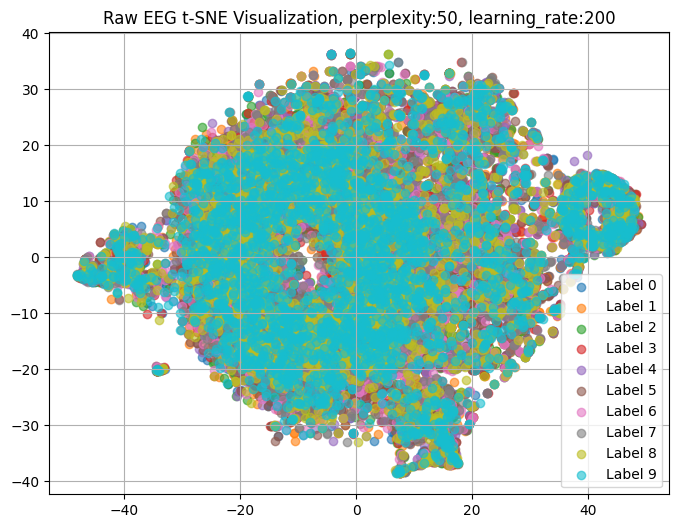

Final KL-Divergence: 3.555048942565918


In [35]:
perplexities = [50]
learning_rates = [200]

for p in perplexities:
    for lr in learning_rates:
        visualize_tSNE(p, lr, X, labels, "Raw EEG t-SNE Visualization", '', '')

In [9]:
from sklearn.manifold import TSNE

def visualize_tSNE_per_label(perplexity, lr, X_batch, labels, title):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    tsne = TSNE ( 
        n_components  = 2,
        perplexity    = perplexity,
        learning_rate = lr,
        n_iter        = 1000,
        random_state  = 42,
        init          = 'pca',
    )
    embedding = tsne.fit_transform(data_flat)

    unique_labels = np.unique(labels)
    num_labels = len(unique_labels)
    cols = 5
    rows = int(np.ceil(num_labels / cols))

    # Compute Scale
    x_min, x_max = embedding[:, 0].min(), embedding[:, 0].max()
    y_min, y_max = embedding[:, 1].min(), embedding[:, 1].max()

    plt.figure(figsize=(4 * cols, 4 * rows))
    for i, label in enumerate(unique_labels):
        idxs = labels == label
        plt.subplot(rows, cols, i + 1)
        plt.scatter(embedding[idxs, 0], embedding[idxs, 1], alpha=0.6, label=f"Label {label}")
        plt.xlim(x_min, x_max)
        plt.ylim(y_min, y_max)
        plt.title(f"Label {label}")
        plt.xticks([])
        plt.yticks([])
        plt.legend()

    plt.suptitle(title, y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

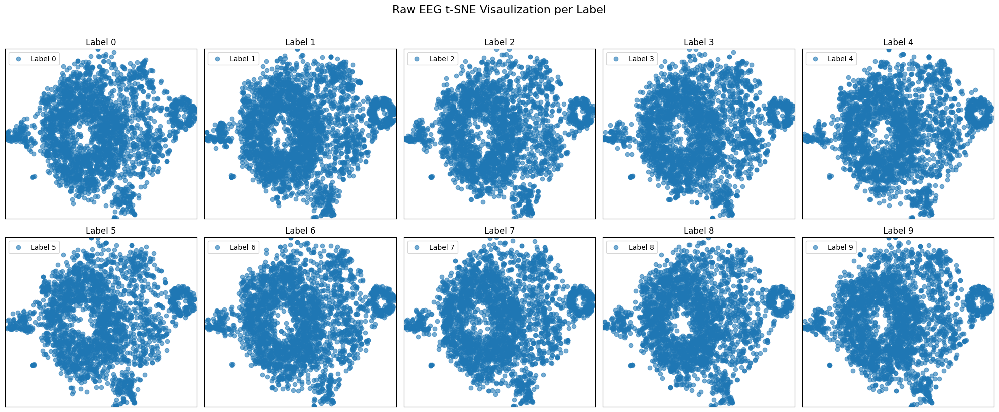

In [37]:
visualize_tSNE_per_label(50, 200, X, labels, "Raw EEG t-SNE Visaulization per Label")

#### UMAP

In [38]:
import umap.umap_ as umap

def visualize_UMAP(X_batch, labels, title):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    
    reducer = umap.UMAP( 
        n_neighbors  = 30,
        min_dist     = 0.1,
        n_components = 2,
        metric       = 'cosine',
        random_state = 42
    )
    embedding = reducer.fit_transform(data_flat)

    plt.figure(figsize=(10, 8))
    for label in np.unique(labels):
        idx = labels == label
        plt.scatter(embedding[idx, 0], embedding[idx, 1], label=f"Label {label}", alpha=0.6, s=10)
    plt.title(title)
    plt.legend()
    plt.show()

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


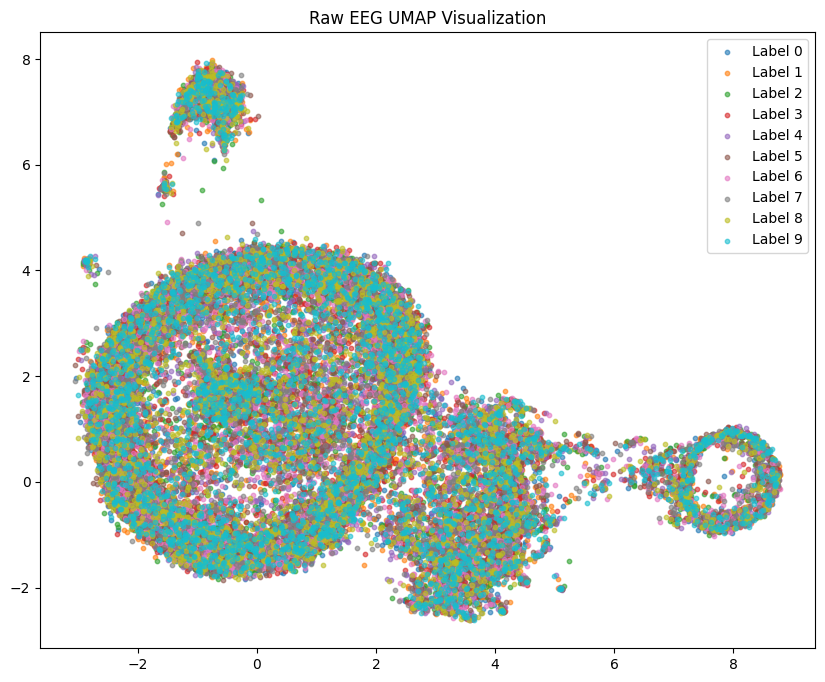

In [39]:
visualize_UMAP(X, labels, "Raw EEG UMAP Visualization")

In [40]:
def visualize_UMAP_per_label(X_batch, labels, title):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    
    reducer = umap.UMAP( 
        n_neighbors  = 30,
        min_dist     = 0.1,
        n_components = 2,
        metric       = 'cosine',
        random_state = 42
    )
    embedding = reducer.fit_transform(data_flat)

    # Comnpute Scale
    x_min, x_max = embedding[:, 0].min(), embedding[:, 0].max()
    y_min, y_max = embedding[:, 1].min(), embedding[:, 1].max()

    num_labels = len(np.unique(labels))
    cols = 5
    rows = int(np.ceil(num_labels / cols))

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
    axes = axes.flatten()

    for i, label in enumerate(np.unique(labels)):
        idx = labels == label
        ax = axes[i]
        ax.scatter(embedding[idx, 0], embedding[idx, 1], alpha=0.6, label=f"Label {label}", s=10)
        ax.set_title(f"Label {label}")
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
        ax.legend()

    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


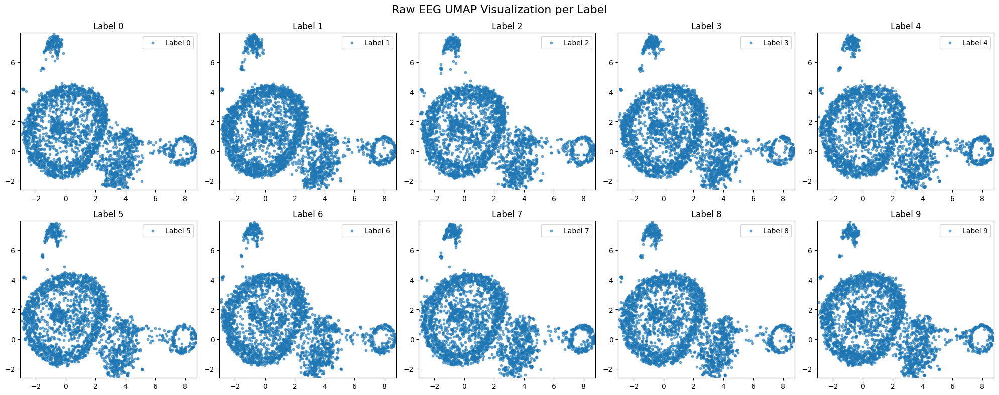

In [41]:
visualize_UMAP_per_label(X, labels, "Raw EEG UMAP Visualization per Label")

### **Signal Analysis (with PyRiemann)**

#### Download Library

In [31]:
!git clone https://github.com/pyRiemann/pyRiemann.git

Cloning into 'pyRiemann'...
remote: Enumerating objects: 4911, done.
remote: Counting objects: 100% (1731/1731), done.
remote: Compressing objects: 100% (631/631), done.
remote: Total 4911 (delta 1473), reused 1101 (delta 1100), pack-reused 3180 (from 3)
Receiving objects: 100% (4911/4911), 1.81 MiB | 6.32 MiB/s, done.
Resolving deltas: 100% (3476/3476), done.


In [32]:
cd "pyRiemann"

/kaggle/working/pyRiemann


In [33]:
!pip install .

Processing /kaggle/working/pyRiemann
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.1/62.1 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.9/16.9 MB 38.6 MB/s eta 0:00:00:00:0100:01
  Created wheel for pyriemann: filename=pyriemann-0.9.dev0-py2.py3-none-any.whl size=127638 sha256=39e86492cda5af0912bbd1951cd7ebef49816fb7481d784626737c5fc42cec1b
  Stored in directory: /tmp/pip-ephem-wheel-cache-6w4imtqw/wheels/26/71/fb/d777be42d312a179173cec7ccc98d027d0ad9ff7ed6168c0ee
Successfully built pyriemann
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gensim 4.3.3 requires numpy<2.0,>=1.18.5, but you have numpy 2.3.1 which is incompatible.
gensim 4.3.3 requ

#### Functions

In [ ]:
from pyriemann.estimation import Covariances
import numpy as np

# X shape: (n_trials, n_channels, n_samples)
covmats = Covariances().fit_transform(X)

sqi_list = []
for cov in covmats:
    eigvals = np.linalg.eigvalsh(cov)
    eigvals = np.sort(eigvals)[::-1]
    
    # Ratio of biggest and smallest eigenvalue
    sqi = eigvals[0] / eigvals[-1]
    sqi_list.append(sqi)

In [72]:
count = 0
good_labels = []
for index, sqi in enumerate(sqi_list):
    if (sqi < 500 and sqi >= 0):
        # print(f"{index}: {sqi}, label: {labels[index]}")
        count = count + 1
        good_labels.append(labels[index])

unique, counts = np.unique(good_labels, return_counts=True)

print(f"Data with good covariances count: {count}")
print(dict(zip(unique, counts)))

Data with good covariances count: 7092
{0: 682, 1: 801, 2: 720, 3: 742, 4: 716, 5: 625, 6: 696, 7: 716, 8: 694, 9: 700}


### Save Raw Data

In [23]:
X_tosave = X.reshape(X.shape[0], -1)
y_tosave = np.argmax(y, axis=1)

pd.DataFrame(X_tosave).to_csv("X_raw_train2B.csv", index=False)
pd.DataFrame(y_tosave, columns=["label"]).to_csv("y_raw_train2B.csv", index=False)

#### Retrieve Raw (Numbers Row Only)

In [1]:
import pandas as pd
import numpy as np
import os

path = "/kaggle/input/raw-eeg-2b"
X_batch = pd.read_csv(os.path.join(path, "X_raw_train2B.csv"), header=0)
y_batch = pd.read_csv(os.path.join(path, "y_raw_train2B.csv"), header=0)

X_batch = X_batch.to_numpy()
labels = y_batch.to_numpy().flatten()

n_channels = 32
n_timesteps = 256
X = X_batch.reshape(-1, n_channels, n_timesteps)

print(X.shape)
print(labels.shape)

(30000, 32, 256)
(30000,)


#### Retrieve Raw (-1 Rows 128Ch 50TS)
##### Note: extracted in seperated file

In [2]:
import numpy as np
import os

path = "/kaggle/input/raw-eeg-2b-blank"
X_batch = np.load(os.path.join(path, "X_raw_train2B_BLANK_50TS.npy"))

n_channels = 128
n_timesteps = 50
blanks = X_batch.reshape(-1, n_channels, n_timesteps)

print(blanks.shape)

(30000, 128, 50)


## DENOISING METHODS
### Main Reference: Gaurav dkk. (EEG - Based Brain Signals Analysis for Imagined Digit Recognition)

### [0] Select Channels 
#### Note: for BLANKS

In [6]:
blanks_selected = blanks[:, ch32_idxin_ch128, :]
print(blanks_selected.shape)

(30000, 32, 50)


### [1] Baseline Correction

In [7]:
import numpy as np

X_corrected = []

for i in range(len(X)):
    baseline_mean = blanks_selected[i].mean(axis=1, keepdims=True)
    X_corrected.append(X[i] - baseline_mean)

X_corrected = np.array(X_corrected)
print(X_corrected.shape)

(30000, 32, 256)


In [72]:
import matplotlib.pyplot as plt
import numpy as np

def show_baseline_corrected_difference(original, corrected, label, channel_num, trial_idx=0):
    n_channels, n_timestamps = original.shape[1], original.shape[2]

    plt.figure(figsize=(12, 3))
    plt.plot(original[trial_idx, channel_num, :], label='Original', alpha=0.6)
    plt.plot(corrected[trial_idx, channel_num, :], label='Baseline Corrected', alpha=0.8)
    plt.title(f'Baseline Corrected Example, Label {label}, Channel {channels_32[channel_num]}')
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.ylim(-60000, 60000)
    plt.legend()
    
    plt.tight_layout()
    plt.show()

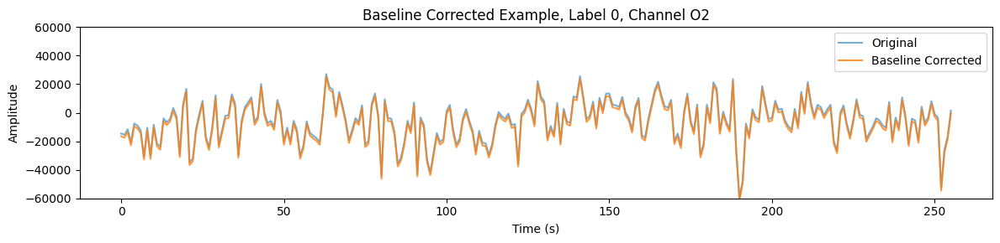

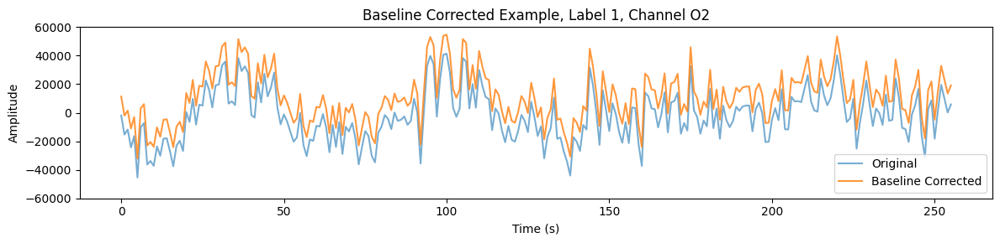

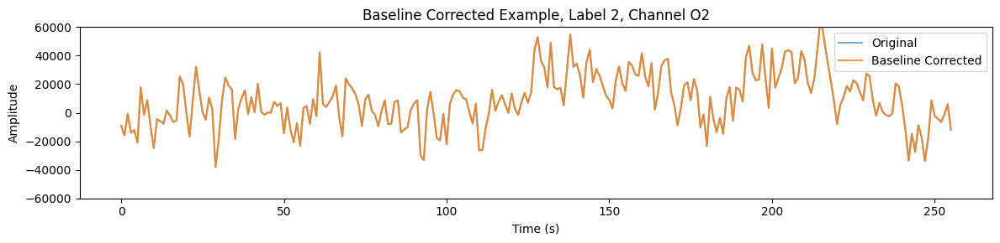

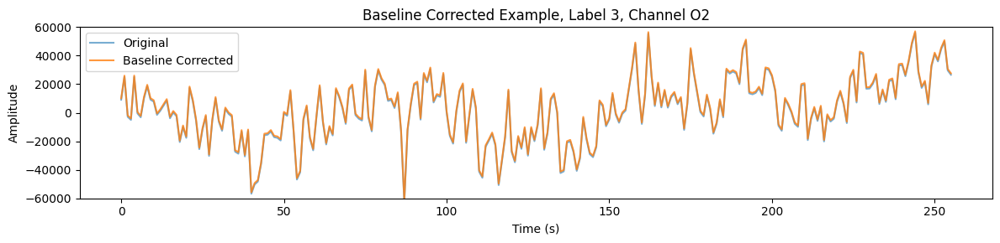

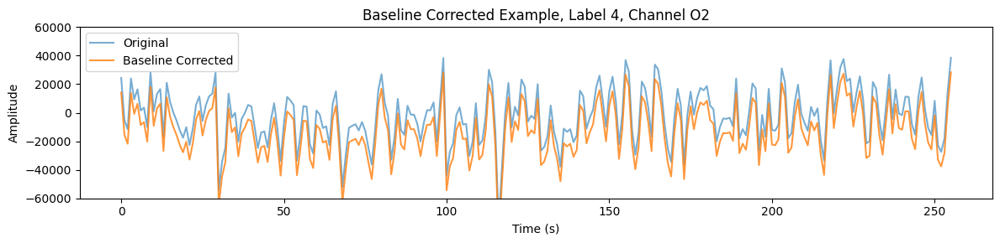

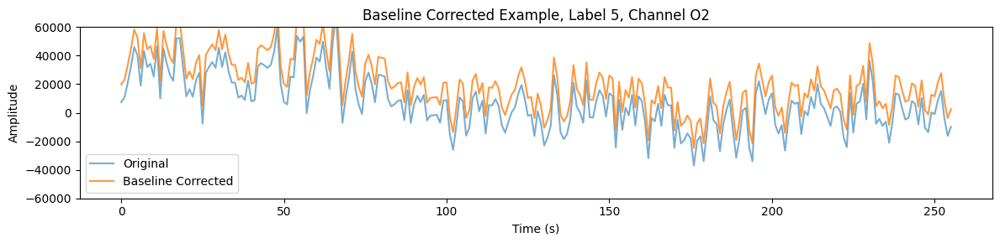

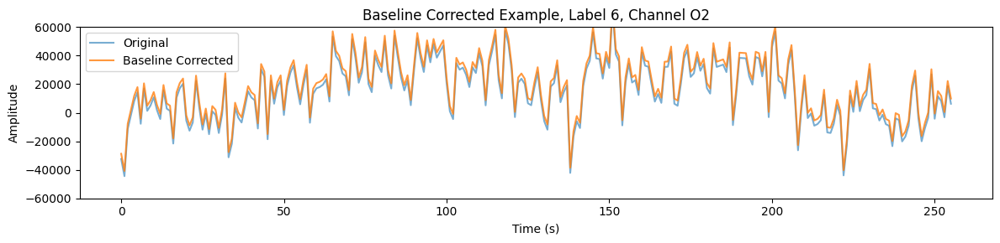

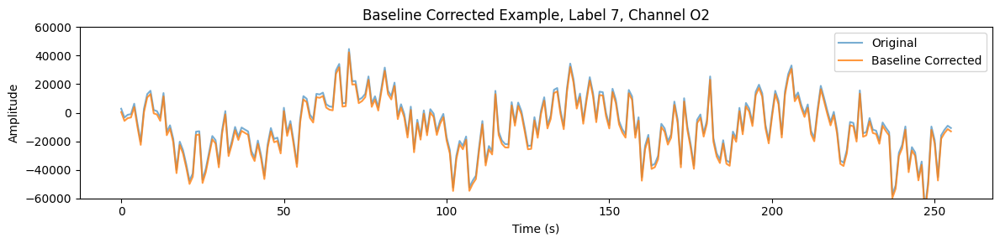

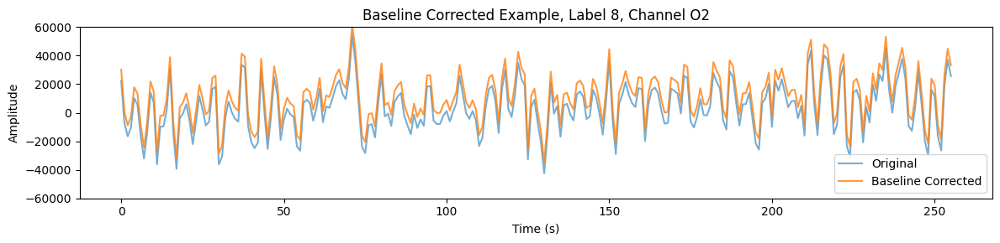

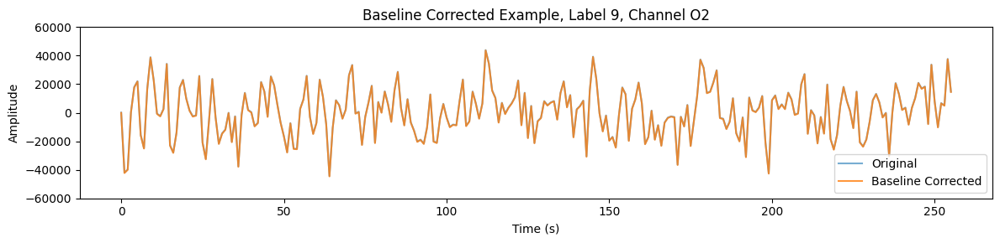

In [73]:
for i in range(10):
    trial_idx = np.where(labels == i)[0][-1:][0]
    show_baseline_corrected_difference (
        X, X_corrected, i,
        trial_idx = trial_idx,
        channel_num = 18,
    )

### [2] Notch Filter for Powerline Frequency

In [8]:
from scipy.signal import iirnotch, filtfilt

def apply_notch_filter(data, freq=50.0, fs=250.0, quality=30):
    b, a = iirnotch(freq, quality, fs)
    filtered_data = filtfilt(b, a, data)
    return filtered_data

In [9]:
import numpy as np

powerline_frequency = 50
notch_filtered_signals = []

for i in range(X_corrected.shape[0]):
    notch_filtered_sample = []
    for ch in range(X_corrected.shape[1]):
        filtered_signal = apply_notch_filter(X_corrected[i, ch, :])
        notch_filtered_sample.append(filtered_signal)
    notch_filtered_signals.append(notch_filtered_sample)

notch_filtered_signals = np.array(notch_filtered_signals)
print(notch_filtered_signals.shape)

(30000, 32, 256)


#### Difference Visualization Example

##### Spatial Domain

In [90]:
import matplotlib.pyplot as plt

def show_notch_filtered_difference(X_batch, labels, filtered, sample_num, channel_num, title):
    original = X_batch[sample_num][channel_num]
    filtered_signal = filtered[sample_num][channel_num]
    
    plt.figure(figsize=(16, 8))
    plt.plot(original, label="Original", alpha=0.5)
        
    plt.plot( filtered_signal, 
              label=f"Notch Filtered @50Hz", 
              linewidth=2 )
    
    plt.title(f"{title}, Label: {labels[sample_num]}, Channel: {channels_32[channel_num]}")
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    plt.ylim(-20000, 20000)
    plt.legend()
    plt.grid(True)
    plt.show()

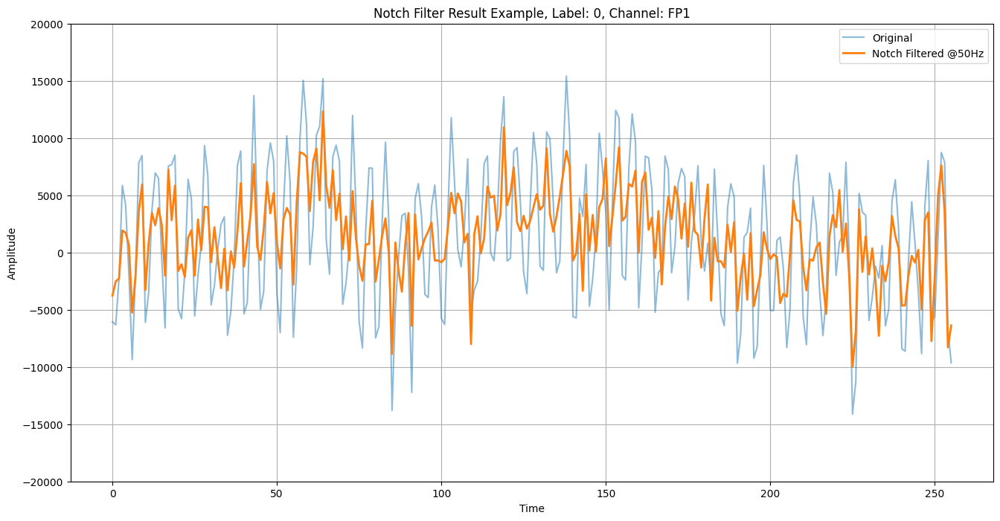

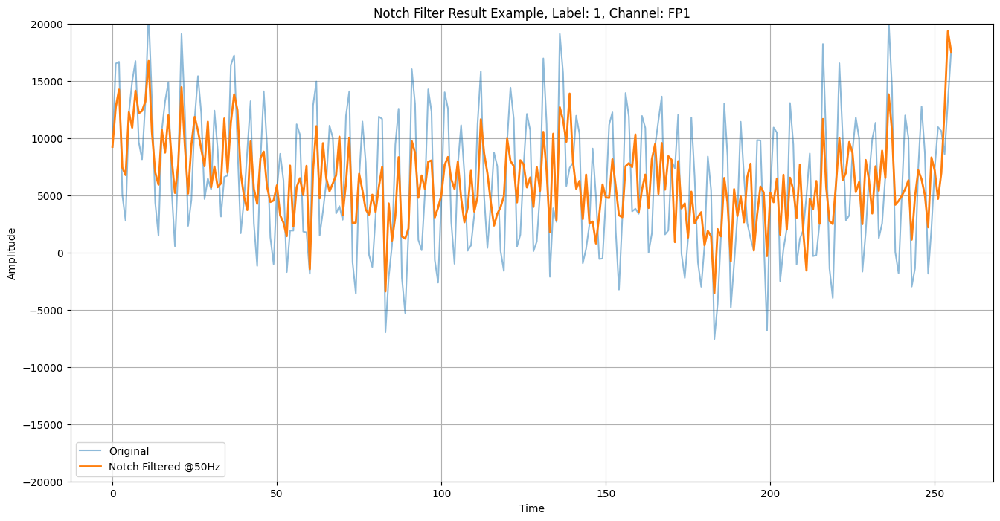

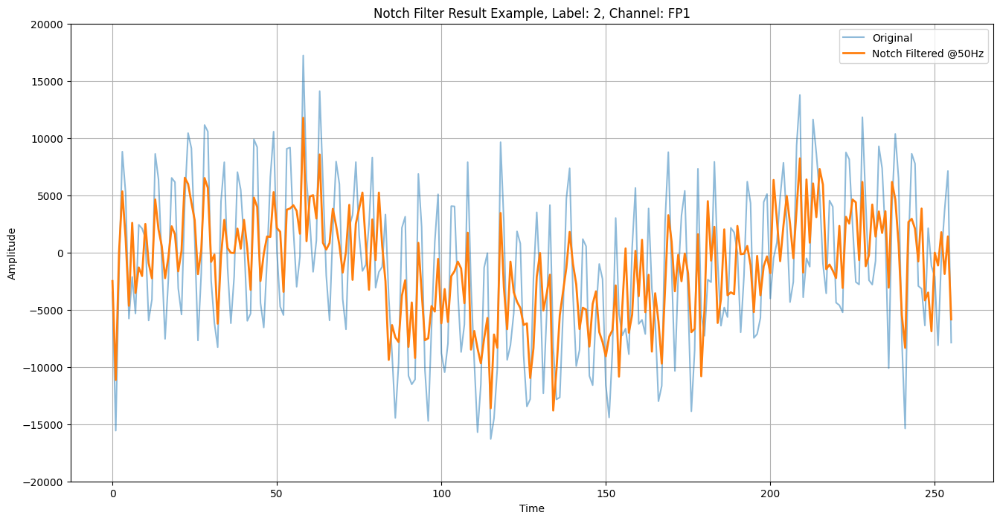

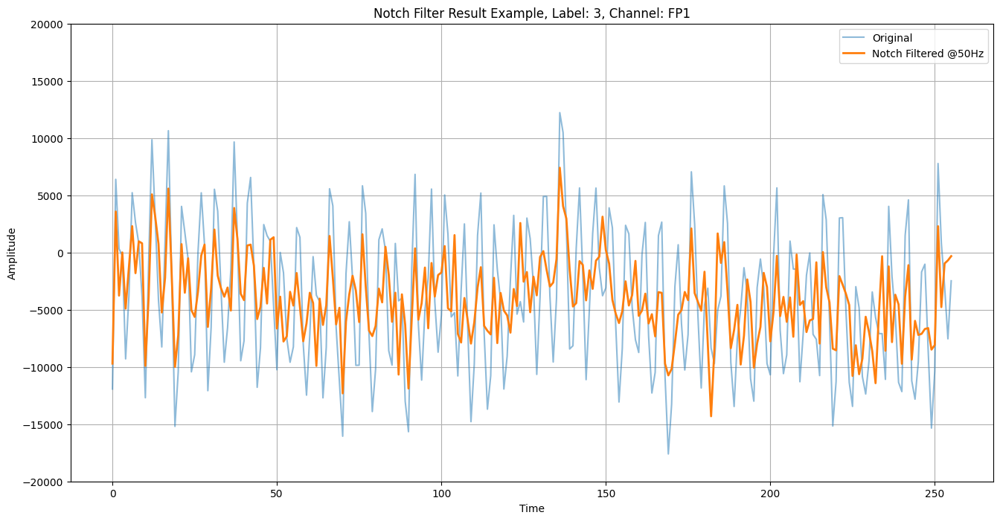

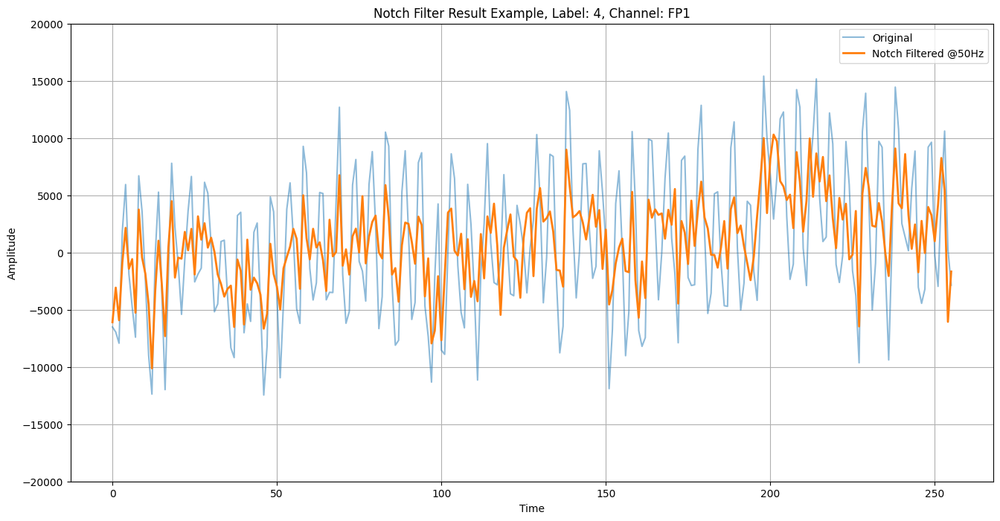

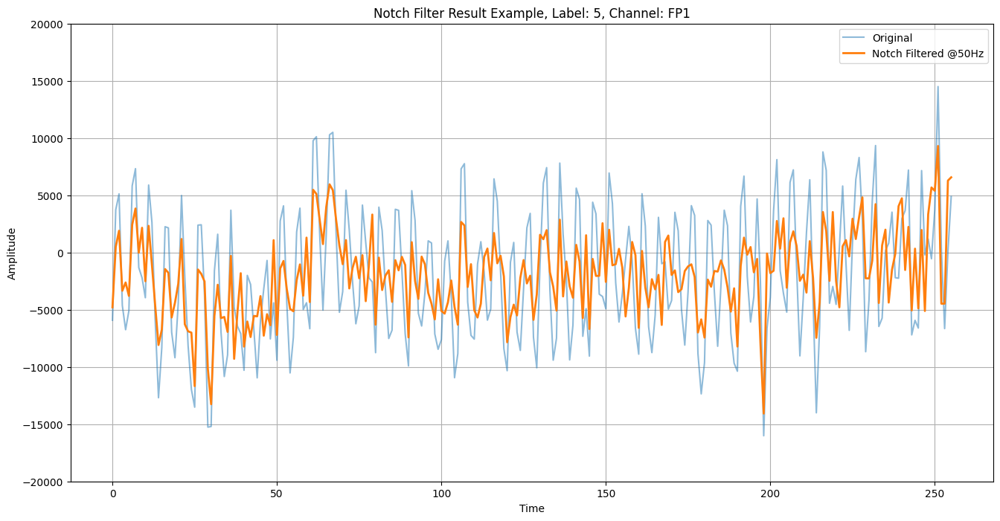

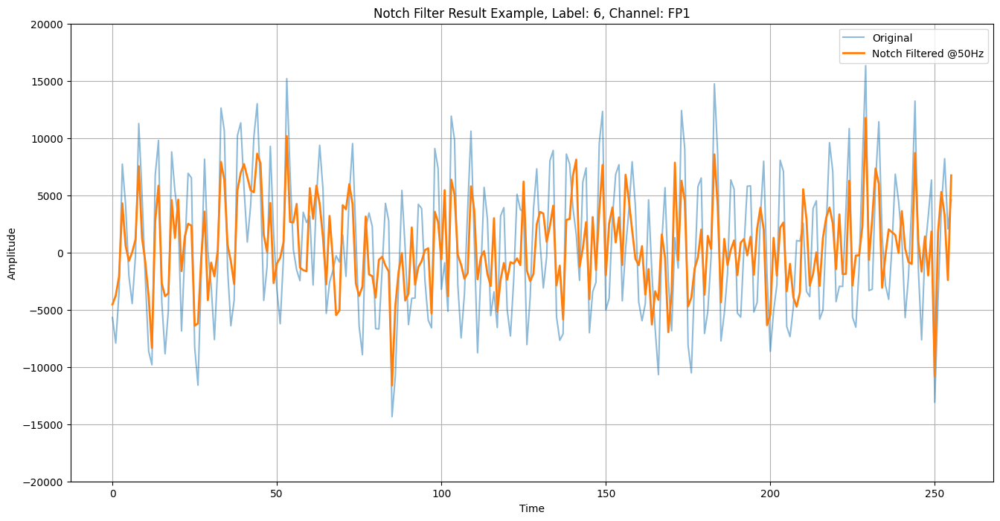

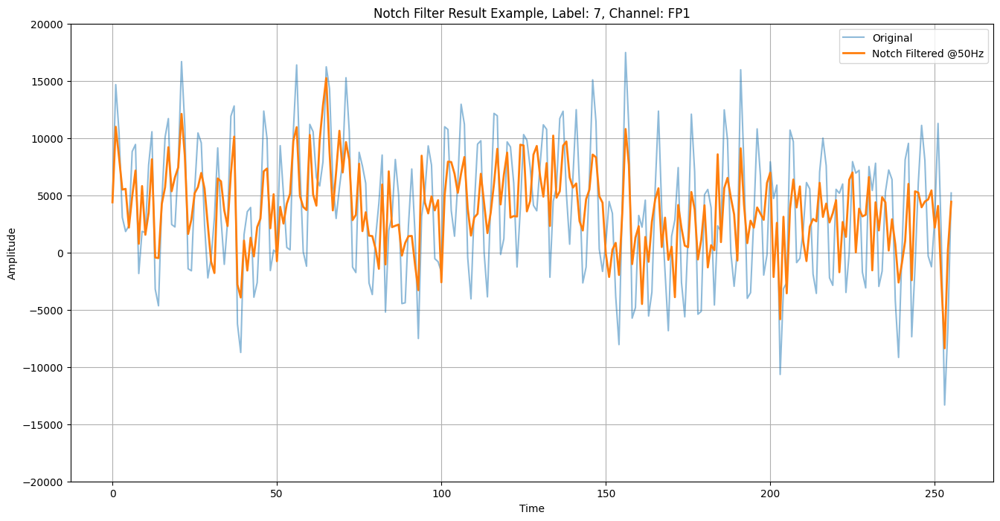

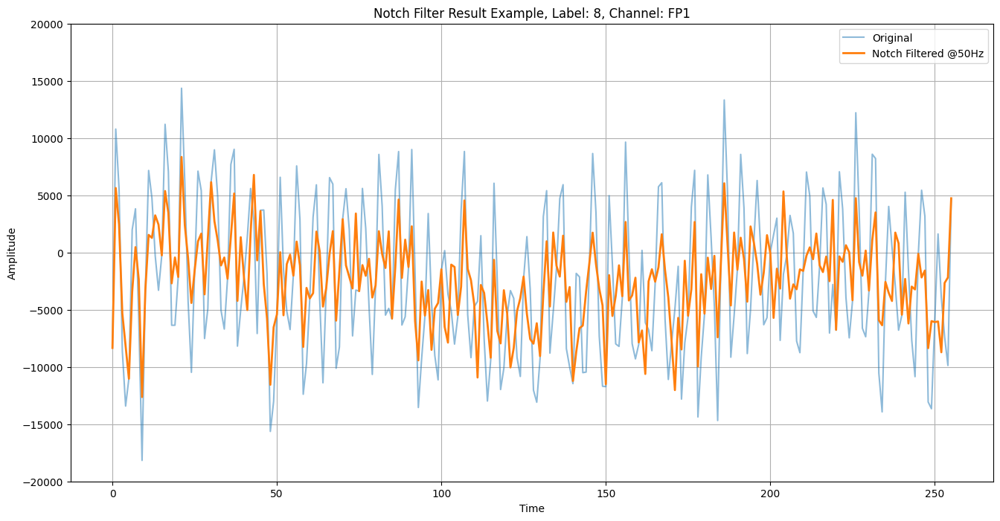

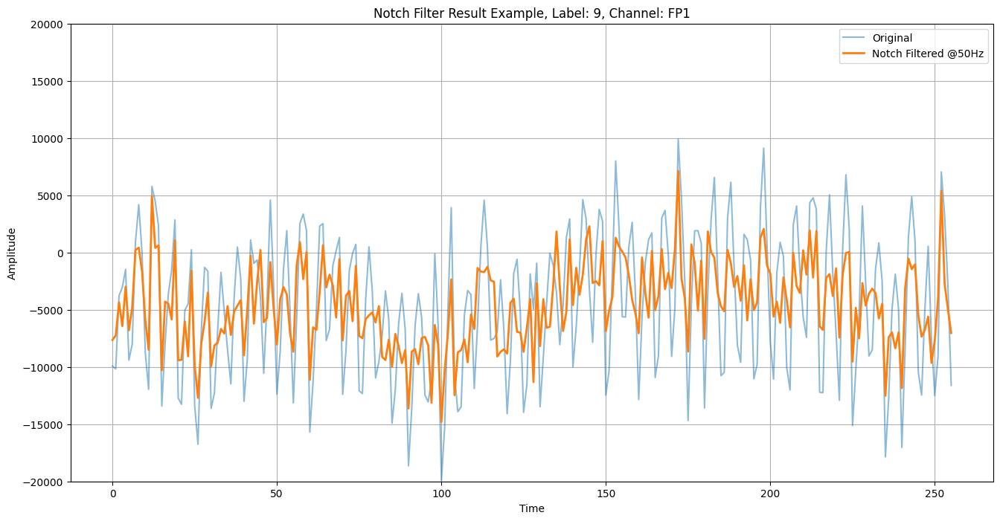

In [91]:
for i in range(10):
    idx = np.where(labels == i)[0][0]
    show_notch_filtered_difference(X_corrected, labels, notch_filtered_signals, idx, 0, "Notch Filter Result Example")

##### Frequency Domain

In [87]:
from scipy.fft import fft, fftfreq

def plot_fft(signal, fs, title):
    N = len(signal)
    yf = fft(signal)
    xf = fftfreq(N, 1 / fs)
    
    idx = np.where(xf >= 0)
    xf = xf[idx]
    yf = np.abs(yf[idx])

    plt.figure(figsize=(10, 4))
    plt.plot(xf, yf)
    plt.title(title)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Amplitude")
    plt.ylim(0, 160000)
    plt.grid(True)
    plt.show()

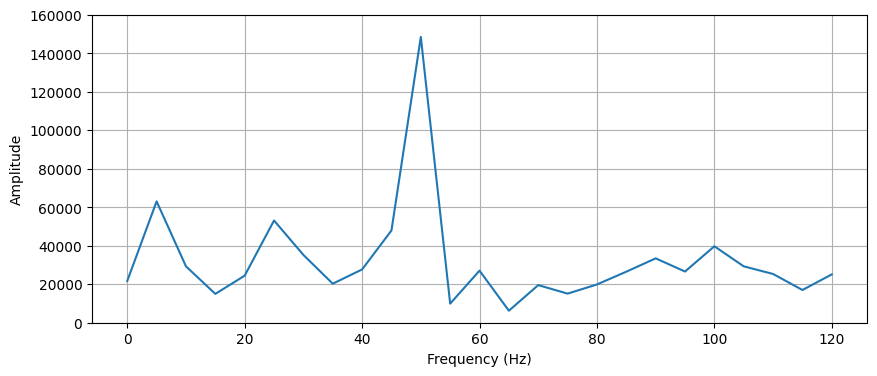

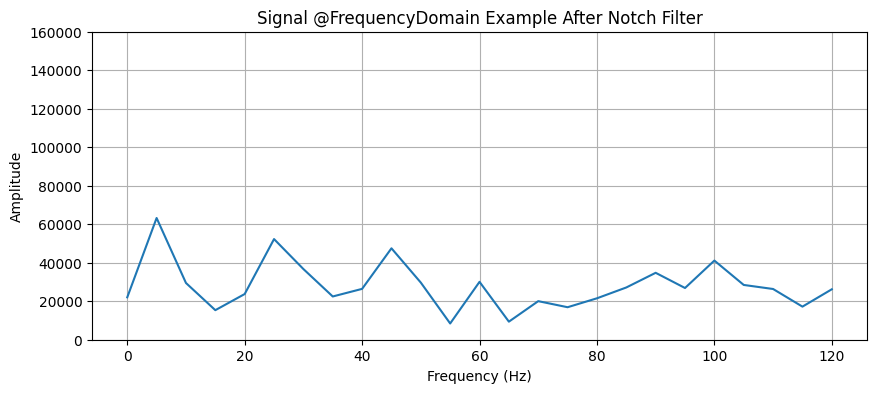

In [88]:
sample_idx = 0
channel_idx = 1

before = X_corrected[sample_idx][channel_idx][:50]
after = notch_filtered_signals[sample_idx][channel_idx][:50]

plot_fft(before, 250, "")
plot_fft(after, 250, "Signal @FrequencyDomain Example After Notch Filter")

#### Save Notch Filtered Data

In [48]:
import pickle

with open("notch_filtered_signals.pkl", "wb") as f:
    pickle.dump(notch_filtered_signals, f)

##### Retrieve Notch Filtered

In [ ]:
# TBA

### [3] Combine Signals

In [10]:
import numpy as np
import random

def combine_signals(X, label, n_per_combine=10, seed=42):
    np.random.seed(seed)
    random.seed(seed)
    
    global_signal_array = []
    global_used_indices = []
    global_final_labels = []
    unique_labels = np.unique(label)
    
    for target_label in unique_labels:
        idx_pool = list(np.where(label == target_label)[0])
        n_output_label = len(idx_pool)
    
        used_combinations = set()
        used_indices_flat = set()
    
        combined = []
        used_indices_list = []
    
        attempts = 0
        max_attempts = 5000
    
        while len(combined) < n_output_label and attempts < max_attempts:
            # Prioritized unused
            unused_pool = list(set(idx_pool) - used_indices_flat)
            pool = unused_pool if len(unused_pool) >= n_per_combine else idx_pool
    
            selected = random.sample(pool, n_per_combine)
            selected_set = frozenset(selected)
    
            if selected_set in used_combinations:
                attempts += 1
                continue
    
            group = X[selected]
            averaged = np.mean(group, axis=0)
    
            combined.append(averaged)
            used_indices_list.append(selected)
            used_combinations.add(selected_set)
            used_indices_flat.update(selected)
            global_final_labels.append(target_label)
    
            attempts = 0
    
        if len(combined) < n_output_label:
            raise RuntimeError(f"Have reached a maximum number of {len(combined)} unique combinations")

        global_signal_array.extend(combined)
        global_used_indices.extend(used_indices_list)
        
    return np.array(global_signal_array), np.array(global_used_indices), np.array(global_final_labels)

In [11]:
combined_signals, used_indices, new_labels = combine_signals(notch_filtered_signals, labels, n_per_combine=10, seed=42)
print(combined_signals.shape)
print(used_indices.shape)
print(new_labels.shape)

(30000, 32, 256)
(30000, 10)
(30000,)


#### Save and Retrieve

In [12]:
np.save("combined_signals.npy", combined_signals)
np.save("used_indices.npy", used_indices)
np.save("new_labels.npy", new_labels)

In [15]:
import os

path = "/kaggle/input/new-bandpass-filtered/"
new_labels = np.load(os.path.join(path, "new_labels.npy"))

### [4] Butterworth Bandpass Filter

In [13]:
from scipy.signal import butter, filtfilt

def butter_bandpass(lowcut, highcut, fs, order=5): 
    nyquist = 0.5 * fs 
    low = lowcut / nyquist 
    high = highcut / nyquist 
    b, a = butter(order, [low, high], btype='band') 
    return b, a 
    
def apply_bandpass_filter(data, lowcut, highcut, fs, order=5): 
    b, a = butter_bandpass(lowcut, highcut, fs, order=order) 
    y = filtfilt(b, a, data) 
    return y 

In [10]:
bands = {
    'delta' : (0.5, 4),
    'theta' : (4, 8),
    'alpha' : (8, 13),
    'beta'  : (13, 30),
    # 'gamma' : (30, 100),
    # 'band'  : (4, 30)
}

In [15]:
from collections import defaultdict

bandpass_filtered_dict = defaultdict(list)

for name, (low, high) in bands.items():
    for i in range(combined_signals.shape[0]):
        filtered_channels = []
        for ch in range(combined_signals.shape[1]):
            filtered_signal = apply_bandpass_filter(combined_signals[i, ch, :], low, high, 250)
            filtered_channels.append(filtered_signal)
        bandpass_filtered_dict[name].append(filtered_channels)

In [16]:
for key in bandpass_filtered_dict:
    bandpass_filtered_dict[key] = np.array(bandpass_filtered_dict[key])
    
for key, value in bandpass_filtered_dict.items():
    print(f"{key}: {value.shape}")

delta: (30000, 32, 256)
theta: (30000, 32, 256)
alpha: (30000, 32, 256)
beta: (30000, 32, 256)


#### Visualize Difference Example

In [23]:
import matplotlib.pyplot as plt

def show_bandpass_filtered_difference(X_batch, labels, filtered_dict, sample_num, channel_num, title):
    original = X_batch[sample_num][channel_num]
    
    plt.figure(figsize=(12, 4))
    plt.plot(original, label="Original", alpha=0.5)
    for band_name in bands:
        filtered_signal = filtered_dict[band_name][sample_num][channel_num]
        low, high = bands[band_name]
        plt.plot( filtered_signal, 
                  label=f"Filtered {band_name.capitalize()}: {low}-{high} Hz", 
                  linewidth=2 )
    
    plt.title(f"{title}, Label: {labels[sample_num]}, Channel: {channels_32[channel_num]}")
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    plt.ylim(-12500, 12000)
    plt.legend()
    plt.grid(True)
    plt.show()

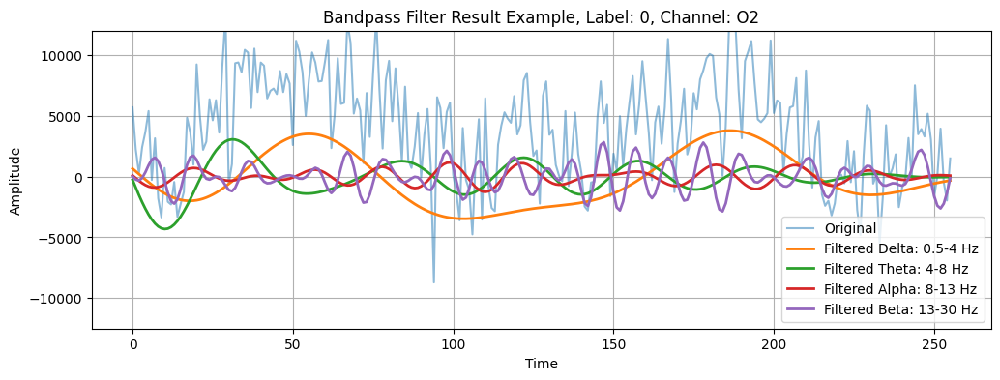

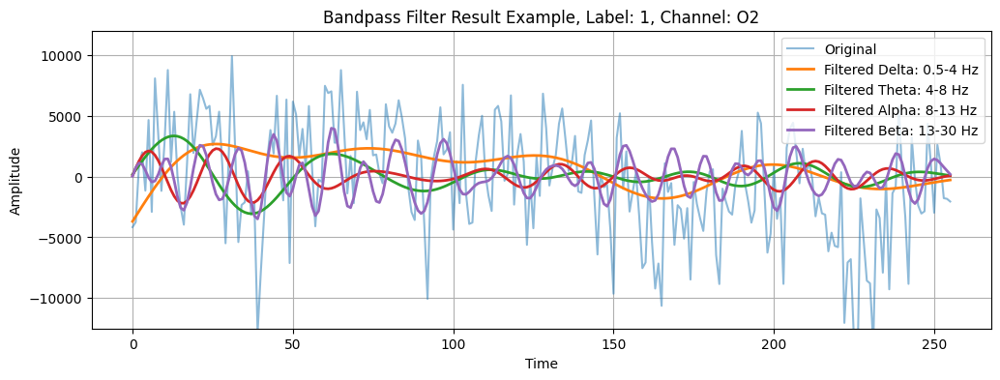

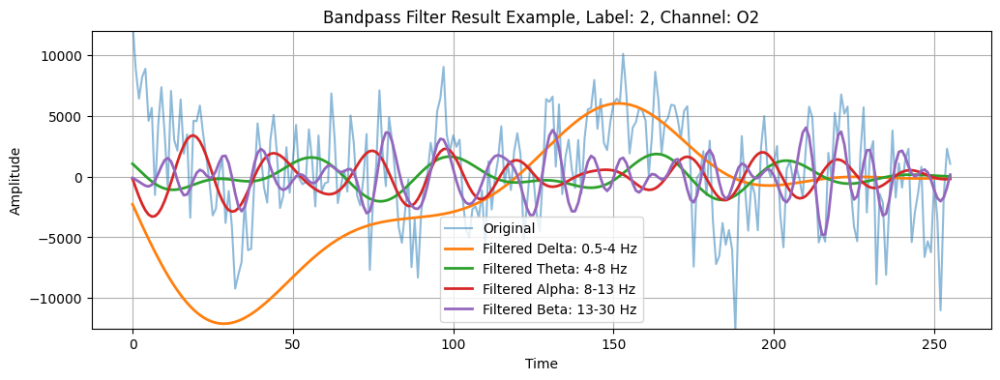

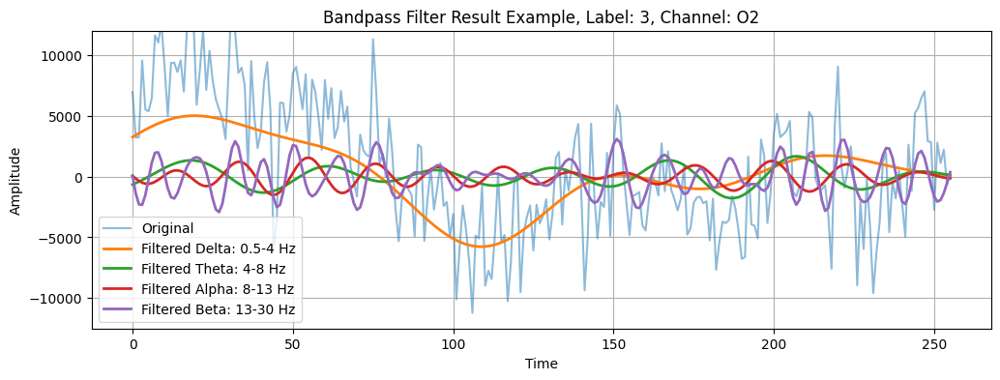

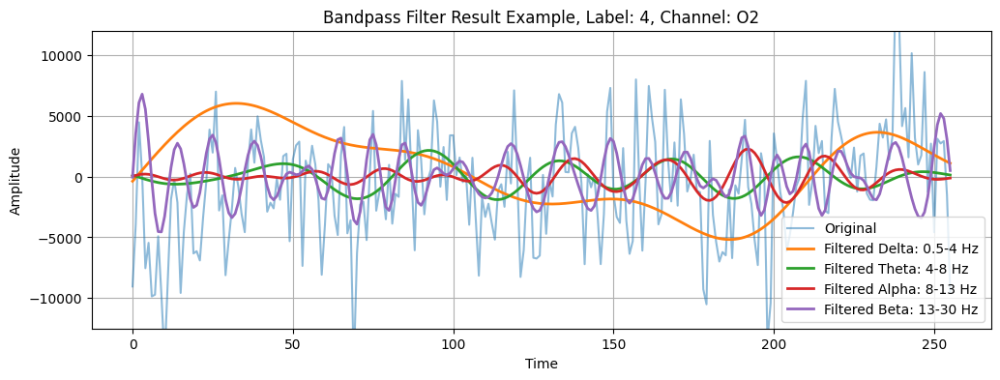

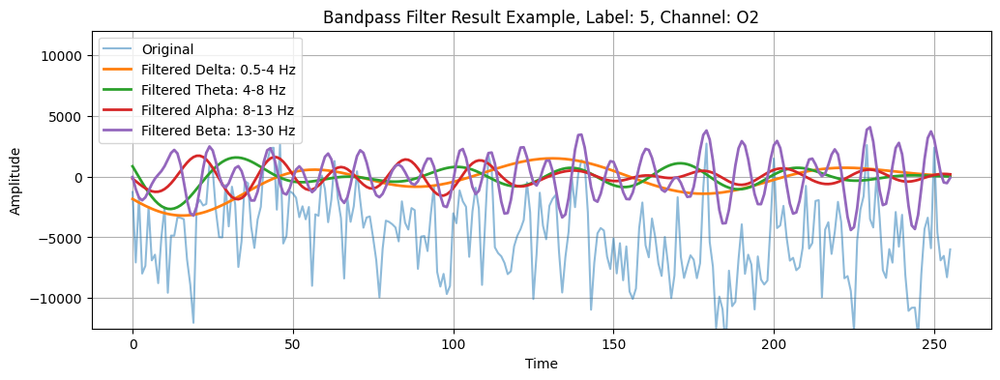

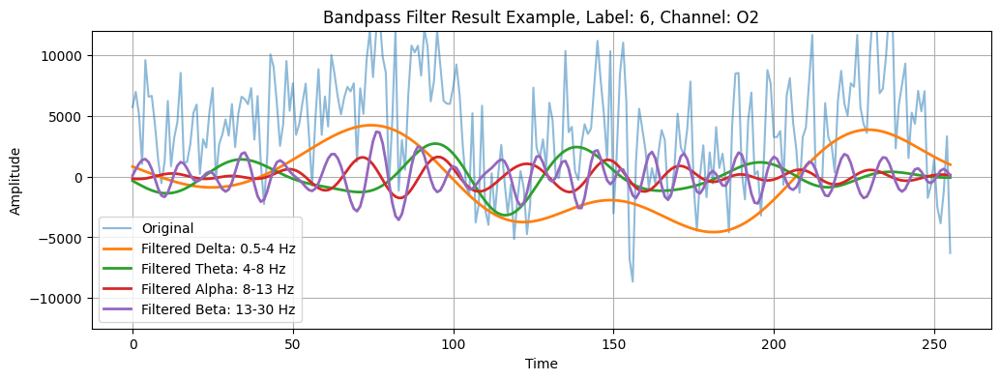

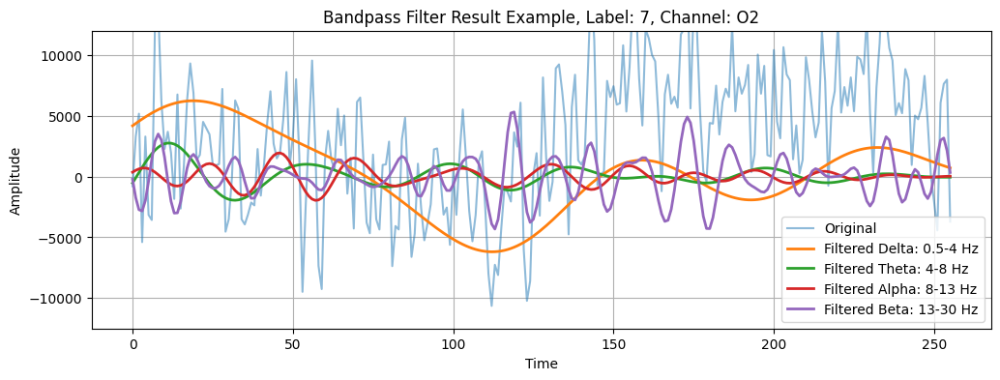

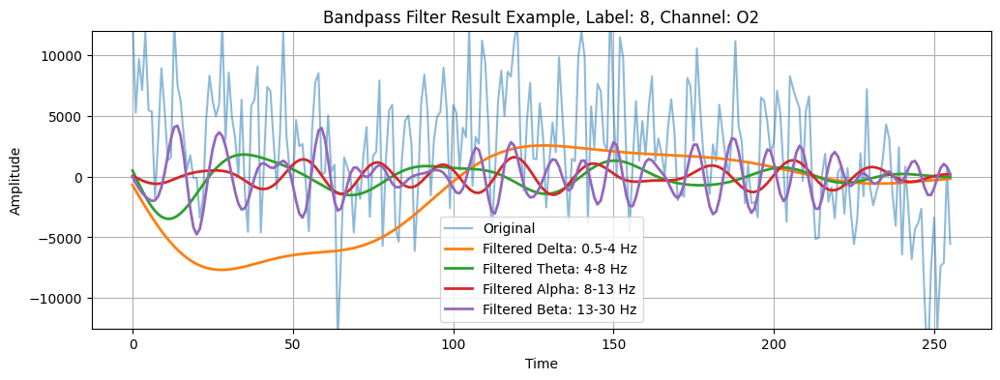

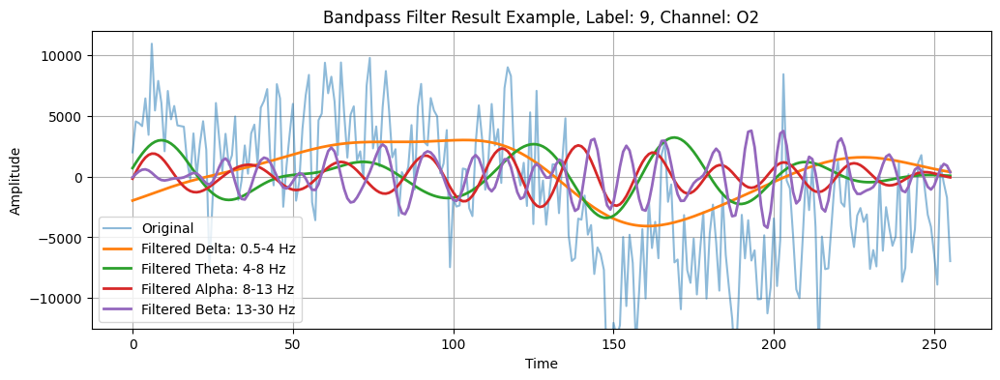

In [24]:
for i in range(10):
    idx = np.where(new_labels == i)[0][0]
    show_bandpass_filtered_difference(combined_signals, new_labels, bandpass_filtered_dict, idx, 18, "Bandpass Filter Result Example")

#### Save Bandpass Filtered Dictionary

In [17]:
import pickle

with open("bandpass_filtered_dict.pkl", "wb") as f:
    pickle.dump(bandpass_filtered_dict, f)

##### Retrieve Bandpass Filtered

In [1]:
import os
import pickle

path = "/kaggle/input/new-bandpass-filtered/"
with open(os.path.join(path, "bandpass_filtered_dict.pkl"), "rb") as f:
    bandpass_filtered_dict = pickle.load(f)

In [2]:
print(bandpass_filtered_dict.keys())

dict_keys(['delta', 'theta', 'alpha', 'beta'])


### [5] Re-referencing

In [3]:
import numpy as np

def rereference(data):
    CAR_data = data - np.mean(data, axis=0)
    return (CAR_data)

In [3]:
for key, data in bandpass_filtered_dict.items():
    bandpass_filtered_dict[key] = data - data.mean(axis=1, keepdims=True)

### [6] Segmentation (Epoching)

In [4]:
import numpy as np

for key, data in bandpass_filtered_dict.items():
    # Timestep 0-124 (125 timesteps, 500 ms)
    bandpass_filtered_dict[key] = data[:, :, :125]

for key, value in bandpass_filtered_dict.items():
    print(f"{key}: {value.shape}")

delta: (30000, 32, 125)
theta: (30000, 32, 125)
alpha: (30000, 32, 125)
beta: (30000, 32, 125)


### [7] Normalization

In [5]:
from sklearn.preprocessing import StandardScaler

def normalize_channels(eeg):
    n_samples, n_channels, n_timesteps = eeg.shape
    reshaped = eeg.transpose(1, 0, 2).reshape(n_channels, -1).T
    
    scaler = StandardScaler()
    scaled = scaler.fit_transform(reshaped)
    
    scaled_data = scaled.T.reshape(n_channels, n_samples, n_timesteps).transpose(1, 0, 2)
    return (scaled_data, scaler)

In [6]:
global_scalers = []
for key, value in bandpass_filtered_dict.items():
    bandpass_filtered_dict[key], scalers = normalize_channels(value)
    global_scalers.append(scalers)

In [7]:
# How to Access Standard Scalers
print (global_scalers[0].mean_)  #mean
print (global_scalers[0].scale_) #std

[-26.22305934 -27.07245533 -35.09382552  -6.81392363  31.50930353
 -31.97692703 -16.45302322  51.76464202  -8.71326997 -24.65751198
 -41.50568259 -14.0752056   -2.65499388 -15.00375887   7.02846336
 -31.84297803 -13.41768013 -42.31557453  73.69427445 -25.26784284
  16.1065246  -18.46126348  28.62542363  16.73756081  -3.00443291
   0.77041572  42.68172722  68.99920974 -26.19657185  66.38082152
  15.129398    -8.67778389]
[1688.86683089 1882.79274282 1238.61634335 1608.07241166 1395.7627305
 2076.16094073 1506.81087765 2754.13548234 3086.60728019 1224.45374859
 1709.2271408  4931.24437063 1811.42483895 1784.69847634 1563.65594778
 1661.91499042 2224.55294436 2473.61840095 2933.12893382 3039.15691482
 2399.26405404 1970.41686776 3166.06163194 2101.35723455 2466.1543404
 2531.7688478  3369.39202887 2827.16559525 2466.62980511 3834.55374252
 3659.63727205 3302.69725396]


#### Save Normalized and Scaler

In [ ]:
# import joblib

# np.save('eeg_normalized.npy', normalized)
# np.save('y_filtered.npy', y_filtered)
# joblib.dump(scalers, 'scaler.pkl')

##### Retrieved Normalized and Scaler

In [ ]:
# TBA

### [8] Augmentation and Upsampling

#### Augmentation Functions

In [9]:
def gaussian_noise(x, scale=0.2):
    std = np.std(x)
    return x + np.random.normal(0, scale * std, size=x.shape)

def mixup(x1, x2, alpha=0.4):
    lam = np.random.beta(alpha, alpha)
    return lam * x1 + (1 - lam) * x2, lam

#### Upsampling with Random Augmentation Function

In [13]:
from collections import Counter
import numpy as np

def upsample_with_augmentation(X_dict, y):
    bands = list(X_dict.keys())
    counter = Counter(y)
    max_count = max(counter.values())

    X_augmented = {band: [] for band in bands}
    y_augmented = []

    augmented_indices = []
    augmentation_methods = []
    duplication_sources = []

    original_length = len(y)

    for label in sorted(counter.keys()):
        idx_label = np.where(y == label)[0]
        n_current = len(idx_label)
        n_to_generate = max_count - n_current

        for _ in range(n_to_generate):
            method = np.random.choice(['gaussian', 'mixup'])

            if method == 'gaussian':
                idx = np.random.choice(idx_label)
                for band in bands:
                    x = X_dict[band][idx]
                    x_aug = gaussian_noise(x)
                    X_augmented[band].append(x_aug)
                source = idx

            elif method == 'mixup':
                idx1, idx2 = np.random.choice(idx_label, 2, replace=True)
                lam = np.random.beta(0.4, 0.4)
                for band in bands:
                    x1 = X_dict[band][idx1]
                    x2 = X_dict[band][idx2]
                    x_aug = lam * x1 + (1 - lam) * x2
                    X_augmented[band].append(x_aug)
                source = ((idx1, idx2), lam)

            y_augmented.append(label)
            augmentation_methods.append(method)
            duplication_sources.append(source)

    # Shuffle
    perm = np.random.permutation(len(y_augmented))
    for band in bands:
        X_augmented[band] = np.array(X_augmented[band])[perm]
    y_augmented = np.array(y_augmented)[perm]
    augmentation_methods = [augmentation_methods[i] for i in perm]
    duplication_sources = [duplication_sources[i] for i in perm]

    # Integrate with original data
    X_final = {}
    for band in bands:
        X_final[band] = np.concatenate([X_dict[band], X_augmented[band]], axis=0)
    y_final = np.concatenate([y, y_augmented], axis=0)
    augmented_indices = list(range(original_length, len(y_final)))

    return (
        X_final,
        y_final,
        augmented_indices,
        augmentation_methods,
        duplication_sources
    )

In [18]:
X_upsampled, y_upsampled, aug_idx, aug_methods, dup_sources = upsample_with_augmentation(bandpass_filtered_dict, new_labels)

In [20]:
for band in X_upsampled:
    print(f"{band}: {X_upsampled[band].shape}")

print("y_aug:", y_upsampled.shape)

print("augmented_indices:", len(aug_idx))
print("augmentation_methods:", len(aug_methods))
print("duplication_sources:", len(dup_sources))

delta: (34230, 32, 125)
theta: (34230, 32, 125)
alpha: (34230, 32, 125)
beta: (34230, 32, 125)
y_aug: (34230,)
augmented_indices: 4230
augmentation_methods: 4230
duplication_sources: 4230


In [21]:
counter_original = Counter(new_labels)
counter_upsampled = Counter(y_upsampled)
counter_methods = Counter(aug_methods)

print(counter_original)
print(counter_upsampled)
print(counter_methods)

Counter({1: 3423, 7: 3107, 3: 3073, 9: 3003, 6: 2975, 0: 2961, 2: 2948, 4: 2926, 8: 2875, 5: 2709})
Counter({0: 3423, 1: 3423, 2: 3423, 3: 3423, 4: 3423, 5: 3423, 6: 3423, 7: 3423, 8: 3423, 9: 3423})
Counter({'mixup': 2126, 'gaussian': 2104})


## Data Review (After Denoising)

In [ ]:
# METRICS
for band in bands.keys():
    print_metrics(calculate_metrics(X_upsampled[band].reshape(X_upsampled[band].shape[0], -1), y_upsampled))



=================================================== METRICS  SUMMARY ===================================================
Label      | Theta Min       | Theta Max       | Theta Avg       | Euclidean Min   | Euclidean Max   | Euclidean Avg  
------------------------------------------------------------------------------------------------------------------------
0          | 0.000079        | 140.176992      | 89.169807       | 0.000131        | 182.881942      | 86.689717      
1          | 37.107870       | 144.393184      | 89.136956       | 43.536716       | 189.597436      | 87.692338      
2          | 0.000000        | 138.607653      | 88.988294       | 0.000001        | 186.191921      | 86.551292      
3          | 0.000001        | 139.527305      | 89.019230       | 0.000003        | 219.724791      | 88.155630      
4          | 0.000000        | 142.325602      | 89.167394       | 0.000000        | 204.993925      | 86.482789      
5          | 0.000037        | 139.824026 

In [10]:
print_metrics(calculate_metrics(X_upsampled['beta'].reshape(X_upsampled['beta'].shape[0], -1), y_upsampled))



=================================================== METRICS  SUMMARY ===================================================
Label      | Theta Min       | Theta Max       | Theta Avg       | Euclidean Min   | Euclidean Max   | Euclidean Avg  
------------------------------------------------------------------------------------------------------------------------
0          | 0.000071        | 113.988647      | 89.820500       | 0.000126        | 141.298034      | 88.005418      
1          | 52.859020       | 117.495336      | 89.829470       | 62.120363       | 143.668423      | 89.307681      
2          | 0.000000        | 114.159442      | 89.770557       | 0.000001        | 137.786238      | 88.102415      
3          | 0.000002        | 112.037529      | 89.801734       | 0.000003        | 139.965014      | 88.658758      
4          | 0.000001        | 116.057968      | 89.815553       | 0.000000        | 152.747415      | 88.003102      
5          | 0.000031        | 115.479728 

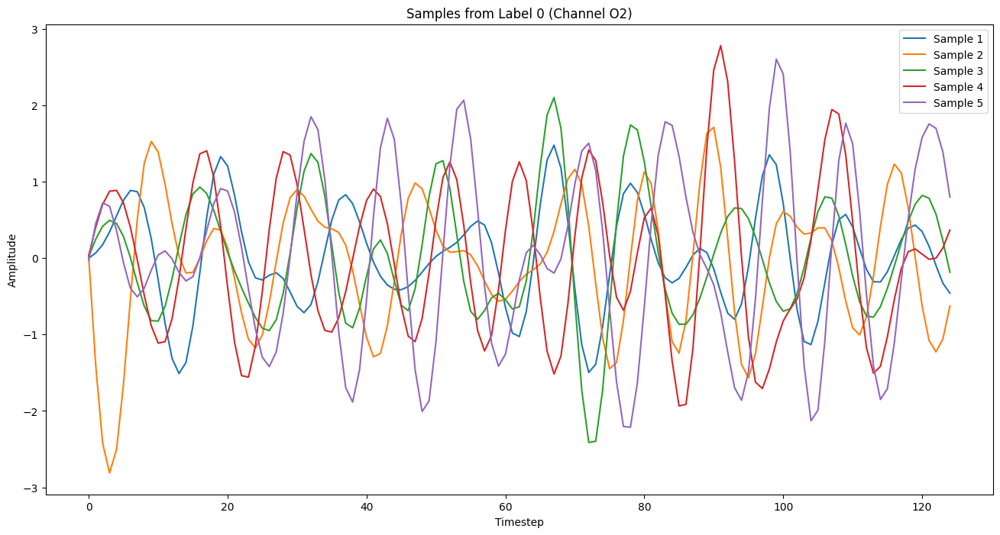

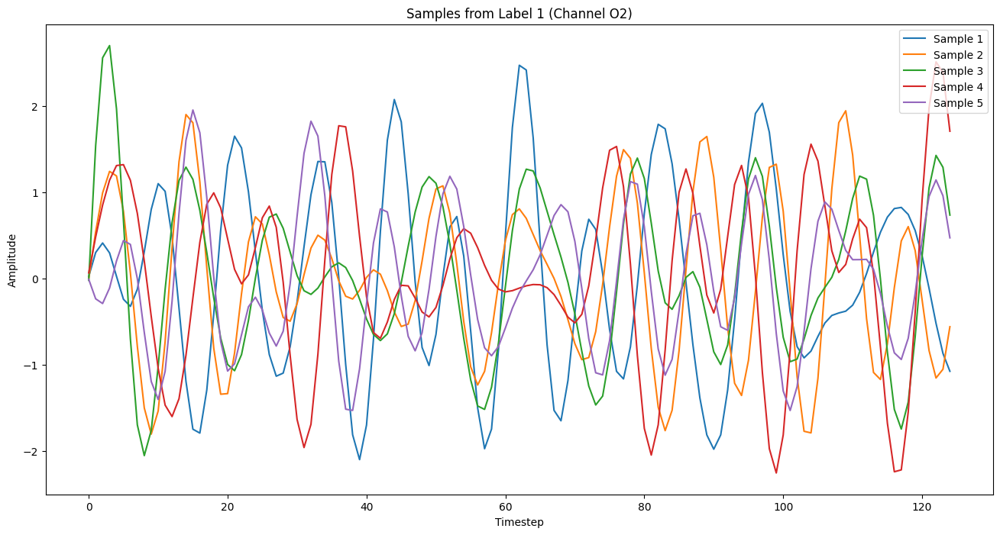

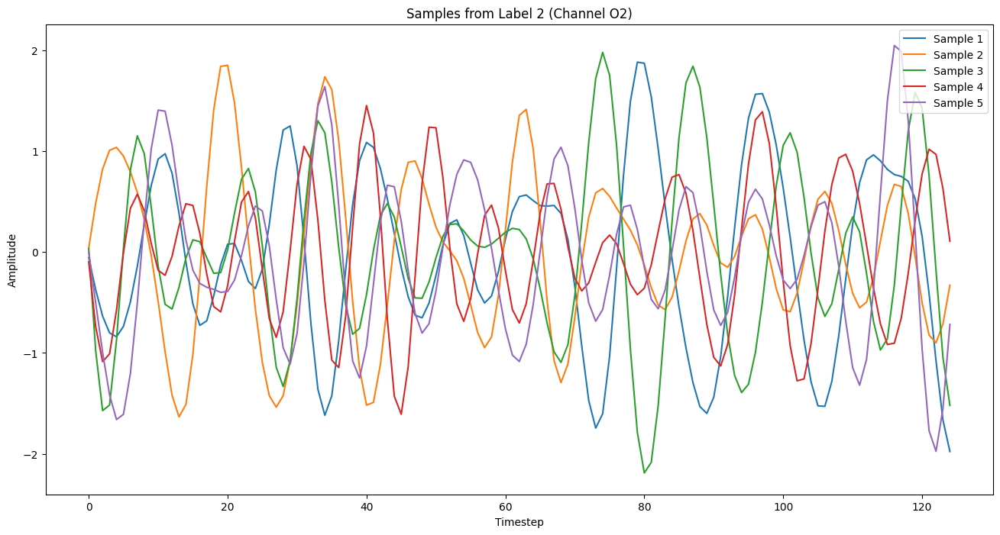

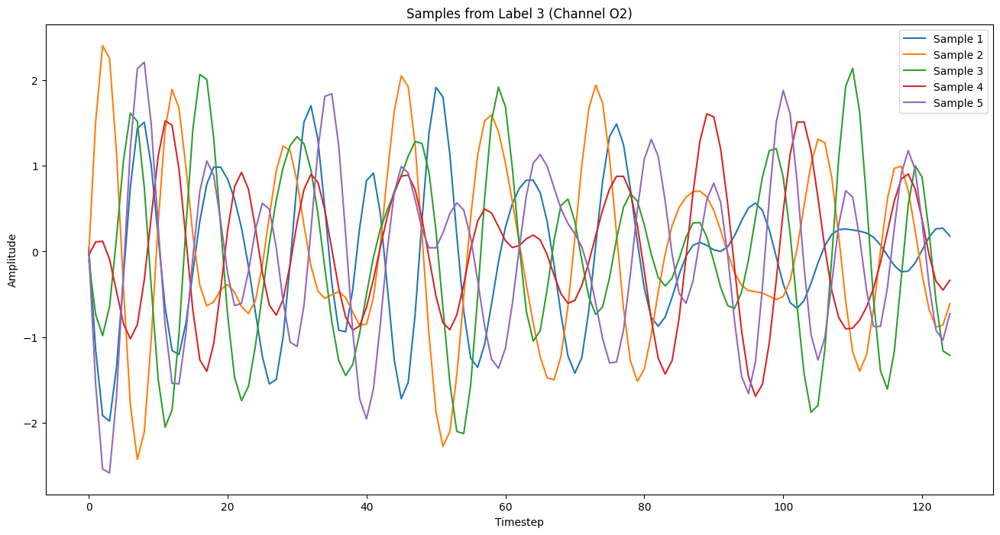

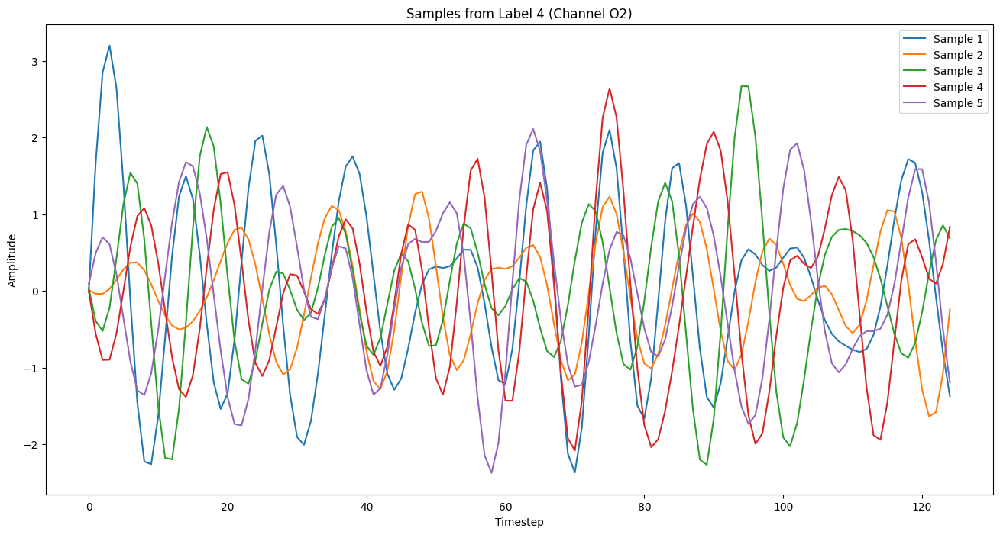

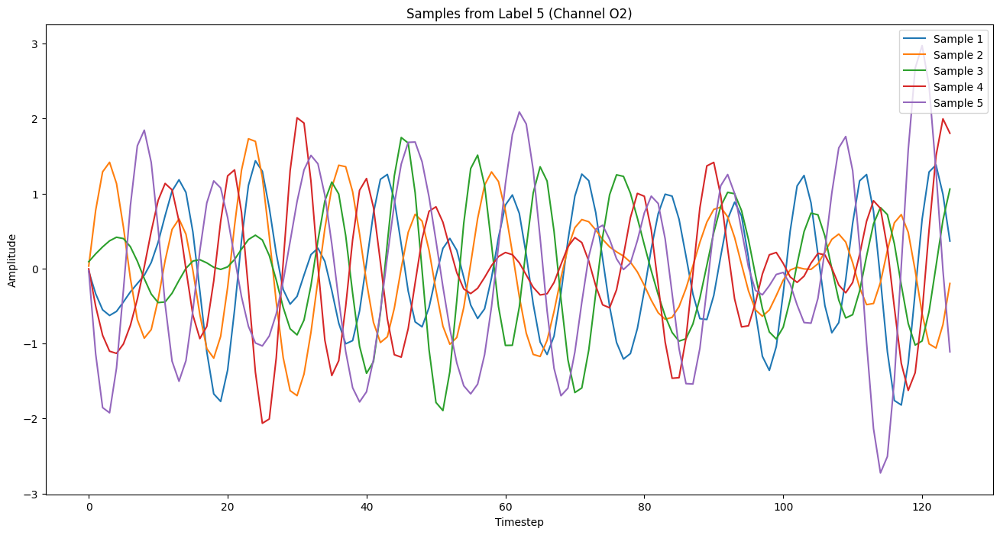

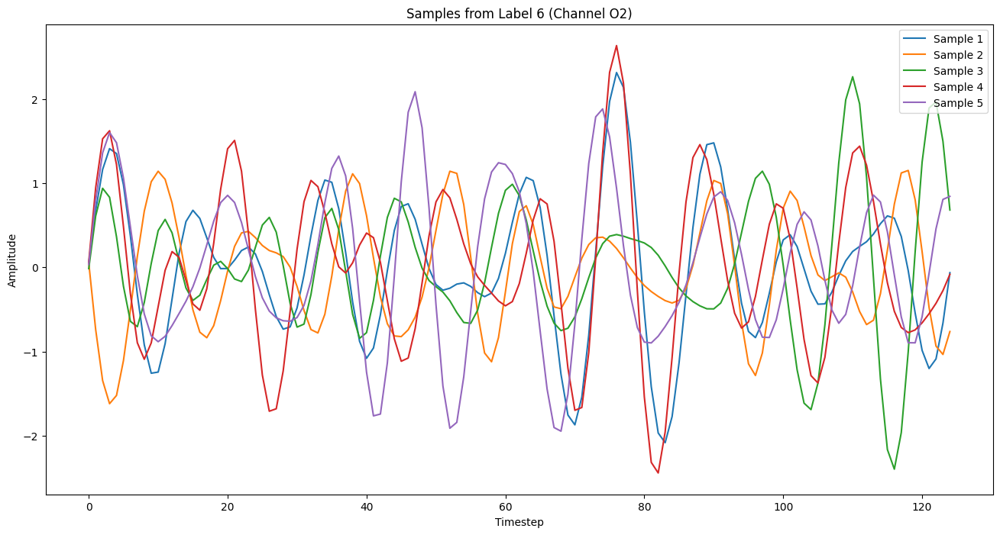

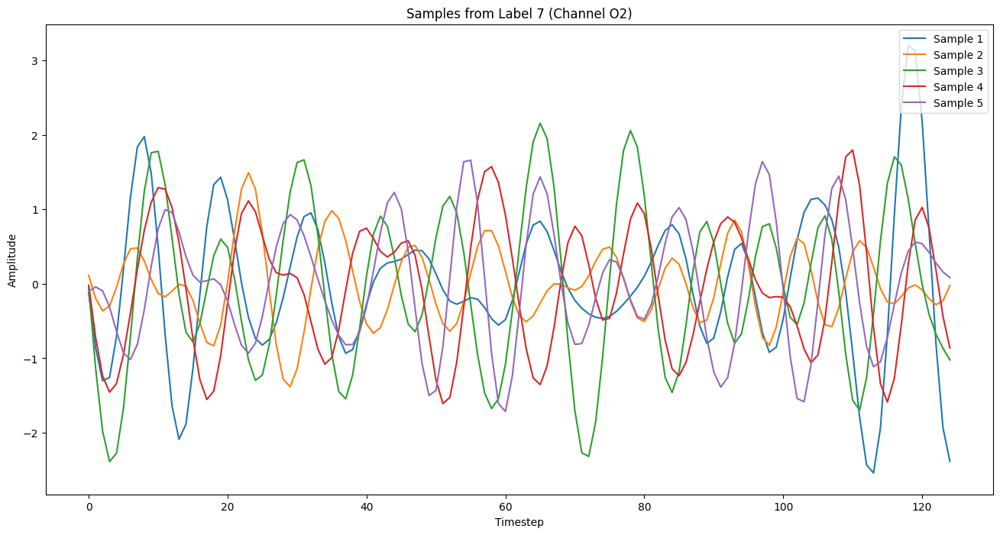

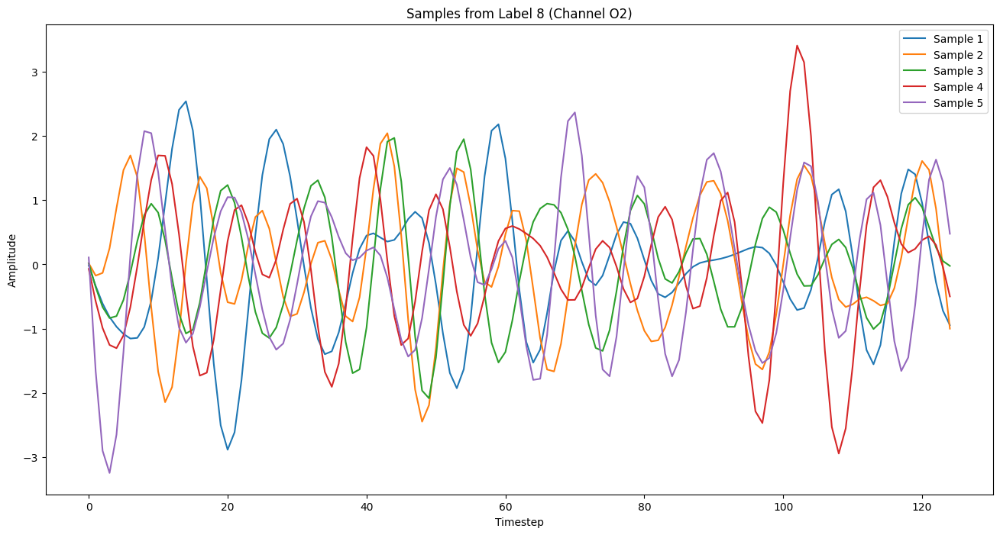

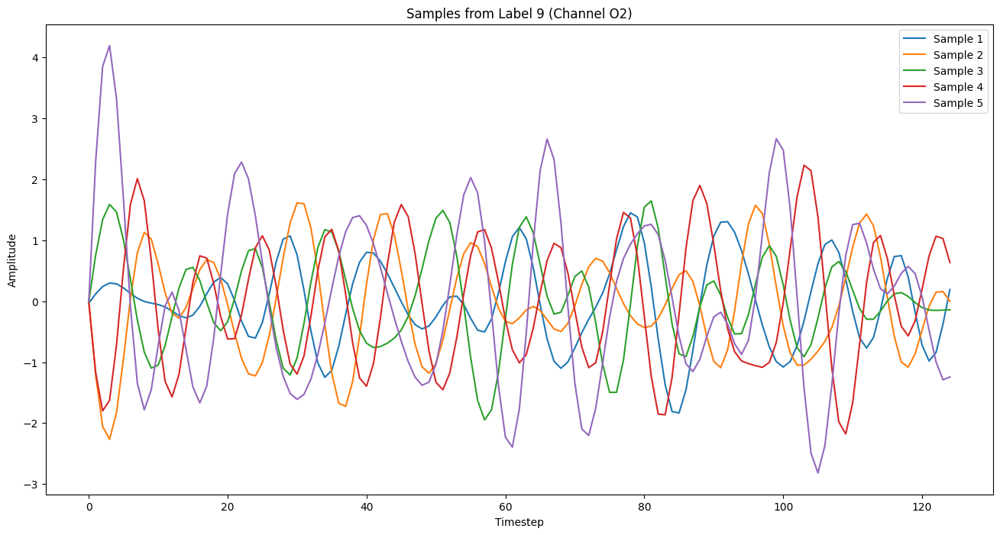

In [16]:
# SAMPLES
show_sample_per_label_per_channel(18, channels_32[18], X_upsampled['beta'], y_upsampled, 5)

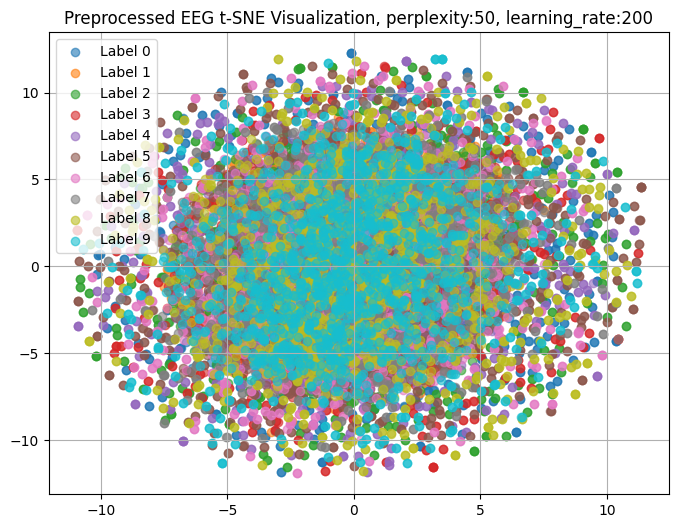

Final KL-Divergence: 4.425358772277832


In [55]:
# t-SNE
perplexities = [50]
learning_rates = [200]

for band in bands.keys():
    for p in perplexities:
        for lr in learning_rates:
            visualize_tSNE(p, lr, X_upsampled[band], y_upsampled, f"Preprocessed EEG t-SNE Visualization, Band: {band}", '', '')

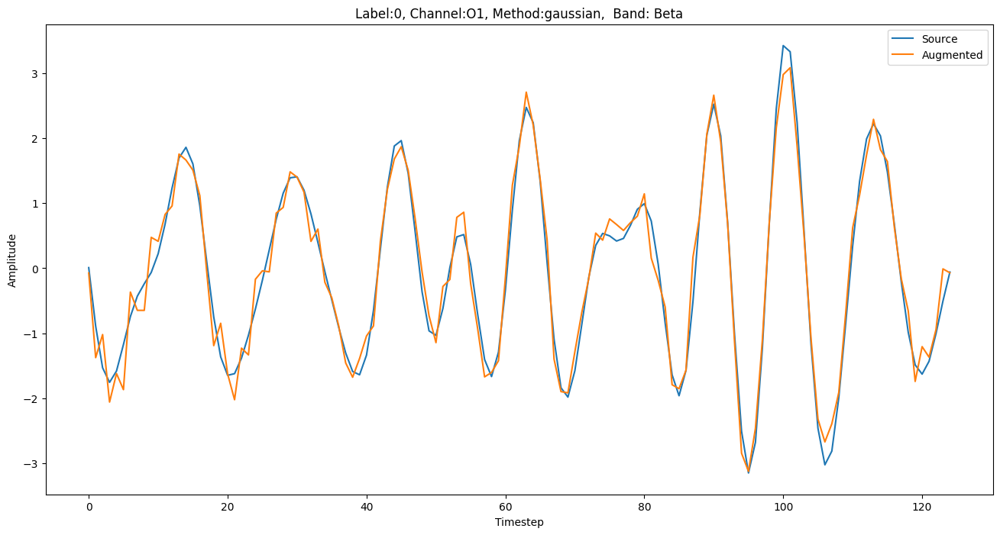

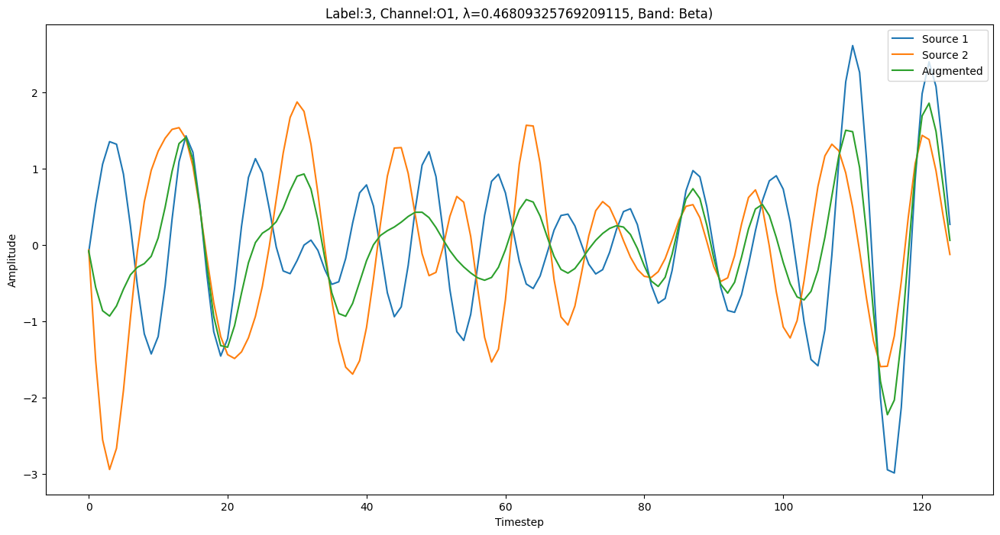

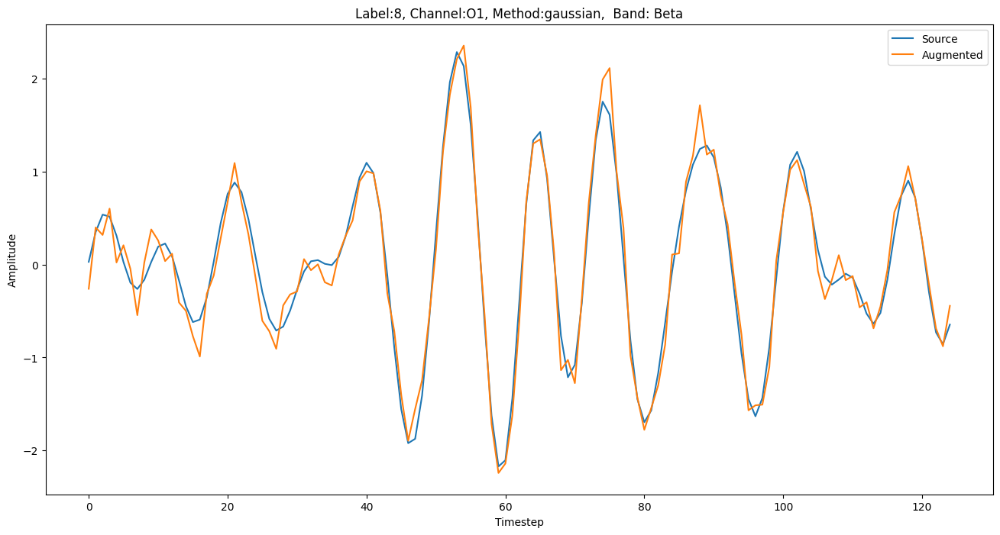

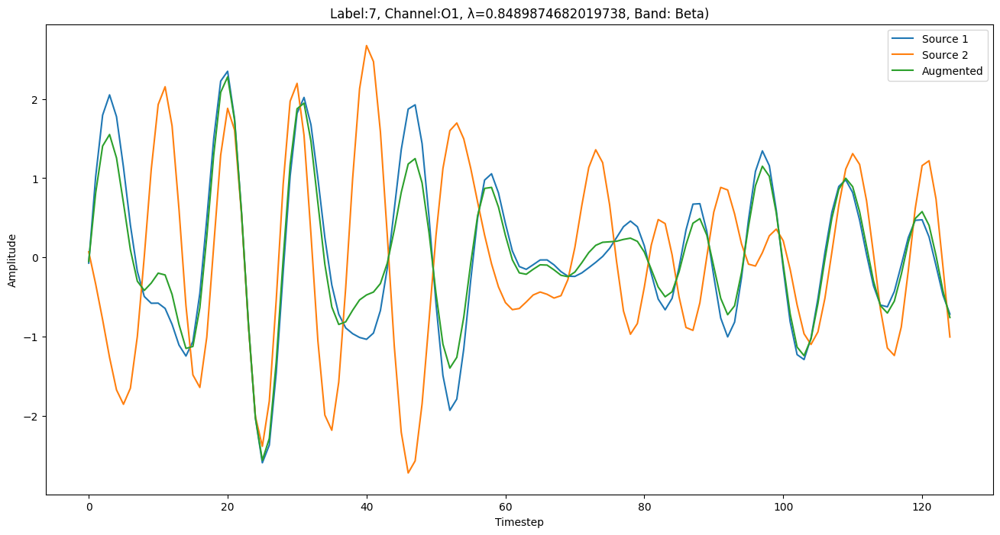

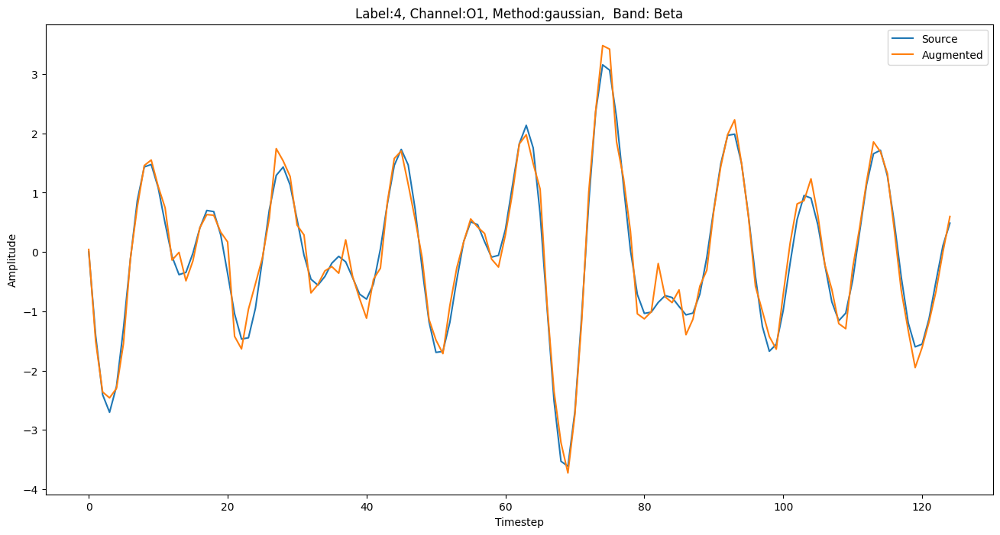

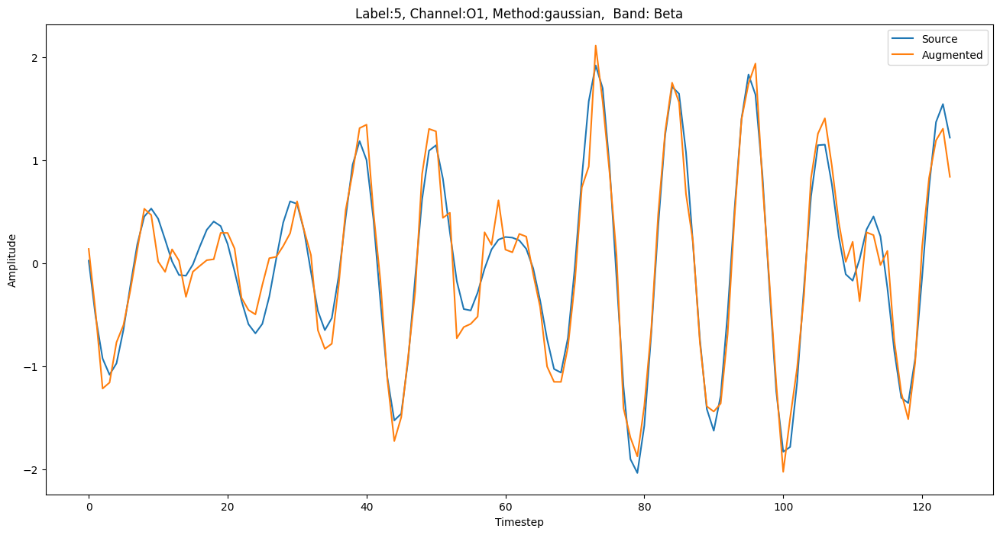

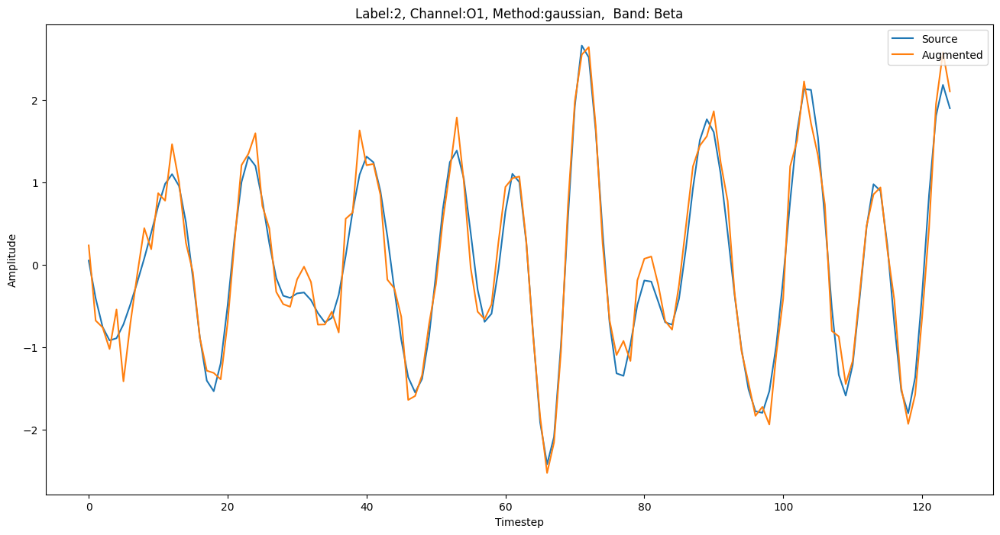

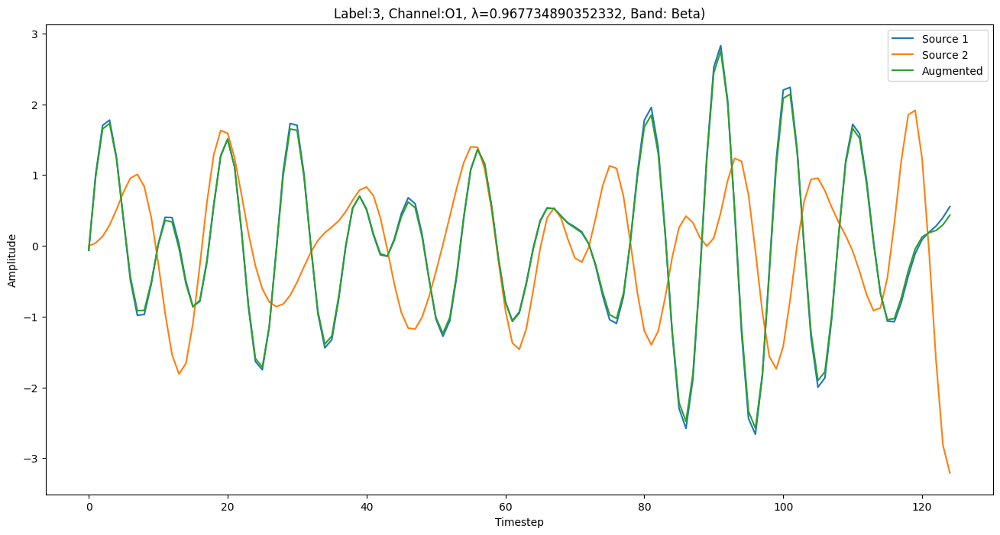

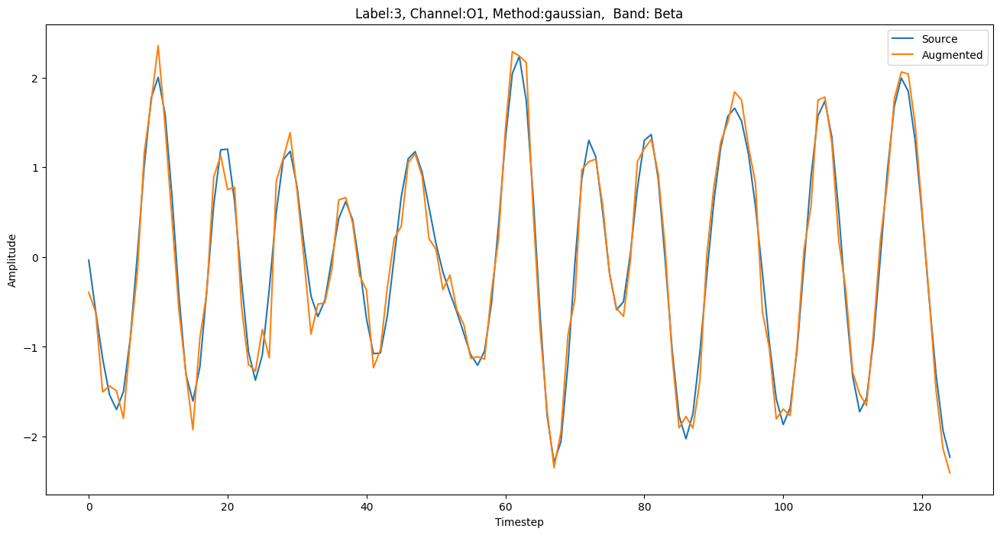

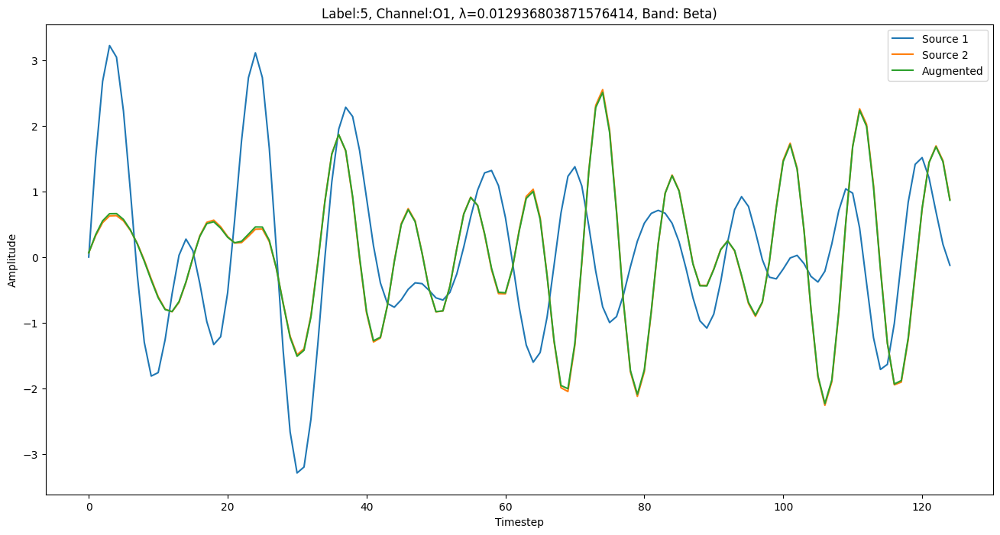

In [8]:
# Visualize Augmented Samples
import matplotlib.pyplot as plt

for i in range(10):
    plt.figure(figsize=(16, 8))
    if isinstance(dup_sources[i], tuple):
        (src1, src2), lam = dup_sources[i]
        plt.plot(X_upsampled['beta'][src1][13], label=f"Source 1")
        plt.plot(X_upsampled['beta'][src2][13], label=f"Source 2")
        plt.title(f"Label:{y_upsampled[src1]}, Channel:{channels_32[13]}, λ={lam}, Band: Beta)")
    else:
        plt.plot(X_upsampled['beta'][dup_sources[i]][13], label=f"Source")
        plt.title(f"Label:{y_upsampled[dup_sources[i]]}, Channel:{channels_32[13]}, Method:{aug_methods[i]},  Band: Beta")
    
    plt.plot(X_upsampled['beta'][30000 + i][13], label=f"Augmented")
    plt.xlabel("Timestep")
    plt.ylabel("Amplitude")
    plt.legend(loc='upper right')
    plt.show()

### Save Preprocessed Data

In [56]:
import pickle

output_dict = {
    'X': {
        band: X_upsampled[band] for band in X_upsampled
    },
    'y': y_upsampled,
    'augmented_indices': aug_idx,
    'augmentation_methods': aug_methods,
    'duplication_sources': dup_sources
}

with open("preprocessed_multiband_eeg.pkl", "wb") as f:
    pickle.dump(output_dict, f)

#### Retrive Processed

In [1]:
import os
import pickle

path = '/kaggle/input/preprocessed-multiband'
with open(os.path.join(path, "preprocessed_multiband_eeg.pkl"), "rb") as f:
    processed = pickle.load(f)

print(processed.keys())
print(processed['X']['delta'].shape)
print(processed['y'].shape)

dict_keys(['X', 'y', 'augmented_indices', 'augmentation_methods', 'duplication_sources'])
(34230, 32, 125)
(34230,)


In [2]:
X_upsampled = processed['X']
y_upsampled = processed['y']

aug_idx = processed['augmented_indices']
aug_methods = processed['augmentation_methods']
dup_sources = processed['duplication_sources']